# Dataset visualization for *ZeoSyn: A Comprehensive Zeolite Synthesis Dataset Enabling Machine-learning Rationalization of Hydrothermal Parameters*

Elton Pan,† Soonhyoung Kwon,‡ Zach Jensen,† Mingrou Xie,‡ Rafael Gomez-Bombarelli,† Manuel Moliner,¶ Yuriy Roman,‡ and Elsa Olivetti∗,†

† Department of Materials Science and Engineering, Massachusetts Institute of Technology, Cambridge, Massachusetts 02139, United States

‡ Department of Chemical Engineering, Massachusetts Institute of Technology, Cambridge, Massachusetts 02139, United States

¶ Instituto de Tecnolog ́ıa Qu ́ımica, Universitat Politecnica de Valencia-Consejo Superior de
Investigaciones Cient ́ıficas, 46022 Valencia, Spain

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import os
import re
import scipy.stats
from scipy.spatial import distance
from scipy.cluster import hierarchy
from rdkit import Chem
from rdkit.Chem import Draw, AllChem
from rdkit.Chem.Draw import rdMolDraw2D
from sklearn.manifold import TSNE
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.preprocessing import OrdinalEncoder, StandardScaler
from s4.ml.plotting import periodic_table_heatmap_sbs, generate_pt_triangulation
from matplotlib.colors import to_rgb, ListedColormap, LogNorm
from utils import MorganDictVectorizer, rename_disordered_interrupted, get_pore_type, clean_cbus, adjacent_values, rmsd_matrix, smoothsegment, tsne_cols, zeo_cols_cont, zeo_cols_disc

In [2]:
# Load synthesis dataset
df      = pd.read_excel('dataset/ZEOSYN.xlsx')

# Load zeolite structural descriptors
df_zeos = pd.read_csv('dataset/zeolite_descriptors.csv').rename(columns = {'Unnamed: 0': 'Code'})

# Load osda descriptors
df_osda = pd.read_csv('dataset/osda_descriptors.csv').drop(columns = {'Unnamed: 0': 'Code'})

In [3]:
df

,Unnamed: 0,Si,Al,P,Na,K,Li,Sr,Rb,Cs,...,osda1 smiles,osda2 smiles,osda3 smiles,osda1 formula,osda2 formula,osda3 formula,Code1,Code2,Code3,year
0,0,0.030769,0.000000,0.0,0.0,0.001538,0.0,0.0,0.0,0.0,...,C[N+]12CCCC[C@@H]1[C@H]1C[C@@H](C2)[C@@H]2CCCC...,NaN,NaN,C16H29N2,NaN,NaN,AFI,NaN,NaN,2002.0
1,1,0.105263,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,C[N+]12CCCC[C@@H]1[C@H]1C[C@@H](C2)[C@@H]2CCCC...,NaN,NaN,C16H29N2,NaN,NaN,AFI,NaN,NaN,2002.0
2,2,0.021959,0.000000,0.0,0.0,0.002635,0.0,0.0,0.0,0.0,...,C[N+](C)(C)C12CC3CC(CC(C3)C1)C2,NaN,NaN,C13H24N,NaN,NaN,AFI,NaN,NaN,2002.0
3,3,0.046512,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,C[N+](C)(C)C12CC3CC(CC(C3)C1)C2,NaN,NaN,C13H24N,NaN,NaN,AFI,NaN,NaN,2002.0
4,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30159,30159,0.967742,0.032258,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,CC[N+]1(CC)CC2CC3CC(C2)CC1C3,NaN,NaN,C14H26N,NaN,NaN,CHA,NaN,NaN,2000.0
30160,30160,0.975610,0.024390,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,CC[N+]1(CC)CC2CC3CC(C2)CC1C3,NaN,NaN,C14H26N,NaN,NaN,CHA,NaN,NaN,2000.0
30161,30161,0.985915,0.014085,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,CC[N+]1(CC)CC2CC3CC(C2)CC1C3,NaN,NaN,C14H26N,NaN,NaN,AFI,NaN,NaN,2000.0
30162,30162,0.990099,0.009901,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,CC[N+]1(CC)CC2CC3CC(C2)CC1C3,NaN,NaN,C14H26N,NaN,NaN,AFI,NaN,NaN,2000.0


In [4]:
# Generate Morgan fingerprints of OSDAs
fpgen = MorganDictVectorizer(radius=5)
mols = [Chem.MolFromSmiles(x) for x in df_osda['osda smiles']]
fpgen.fit(mols)
fps = fpgen.transform(mols)
fps = pd.DataFrame(fps, columns = [f'morgan{x}' for x in range(fps.shape[-1])])
df_osda = pd.concat([df_osda, fps], axis = 1)

In [5]:
# Select subset of osda features
osda_cols = [col for col in df_osda.columns if \
                     ('box' not in col) and \
                     ('binding' not in col) and \
                     ('getaway' not in col) and \
                     ('whim' not in col) and \
                     ('std' not in col) \
                    ]
df_osda = df_osda[osda_cols]
df_osda.columns = ['osda_'+col if 'smiles' not in col else col for col in df_osda.columns]
df_osda_all_feats = df_osda

In [6]:
# Merge main dataset with zeolite descriptors, then with osda descriptors
df = df.merge(df_zeos, left_on='Code1', right_on='Code', how = 'left')
df = df.merge(df_osda, left_on='osda1 smiles', right_on='osda smiles', how = 'left')

# Replace NaN in osda featurizations with 0 - physical?
for osda_col in osda_cols:
    df.loc[:, df.columns.str.contains(osda_col)] = df.loc[:, df.columns.str.contains(osda_col)].fillna(0)

In [7]:
# Rename disordered interrupted three-lettered codes to their full names
df_zeos['Code'] = df_zeos['Code'].apply(rename_disordered_interrupted)

In [8]:
# Small pore zeolites (8MR), Medium pore zeolites (10MR), Large pore zeolites (12MR), Extra large pore zeolites (>12MR)
s_pore = list(df_zeos[(df_zeos['ring_size_0'] >  0.) \
                    & (df_zeos['ring_size_0'] <= 8.) \
                    & (~df_zeos['ring_size_0'].isna()) \
                         ]['Code'])

m_pore = list(df_zeos[(df_zeos['ring_size_0'] > 8.) \
           & (df_zeos['ring_size_0'] <= 10.) \
           & (~df_zeos['ring_size_0'].isna()) \
                         ]['Code'])

l_pore = list(df_zeos[(df_zeos['ring_size_0'] > 10.) \
                    & (df_zeos['ring_size_0'] <= 12.) \
                    & (~df_zeos['ring_size_0'].isna()) \
                         ]['Code'])

xl_pore = list(df_zeos[(df_zeos['ring_size_0'] > 12.) \
                     & (~df_zeos['ring_size_0'].isna()) \
                         ]['Code'])

In [9]:
# Look at pore distribution
df_s_pore = df[df['Code1'].isin(s_pore)]
df_m_pore = df[df['Code1'].isin(m_pore)]
df_l_pore = df[df['Code1'].isin(l_pore)]
df_xl_pore = df[df['Code1'].isin(xl_pore)]

print('Number of synthesis routes resulting in small, medium, large, x-large pore zeolites:')
len(df_s_pore), len(df_m_pore), len(df_l_pore), len(df_xl_pore) 

Number of synthesis routes resulting in small, medium, large, x-large pore zeolites:


(5250, 5494, 5769, 716)

# Zeolite framework distribution

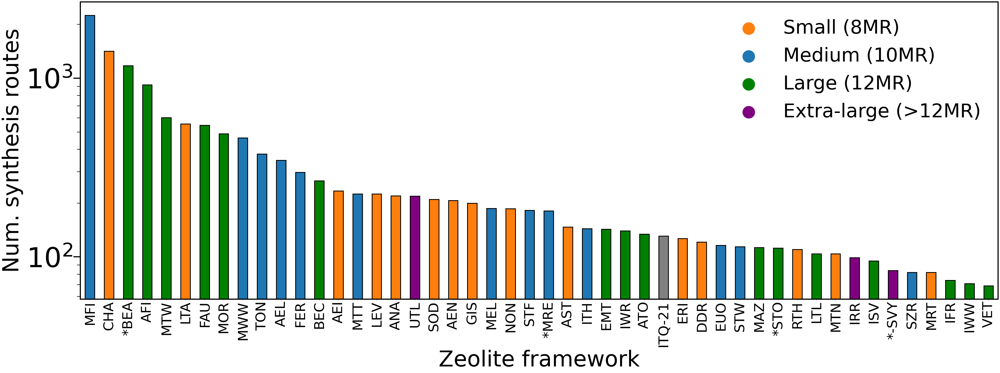

In [10]:
n_frameworks = 50
zeos_value_counts = df['Code1'].value_counts()[:n_frameworks]
zeos_value_counts = zeos_value_counts[~zeos_value_counts.index.str.contains('/')]

fig, ax = plt.subplots(figsize=(60,20))

# Create colors, orange for those of interest, red for failed, blue for all else
colors = ['grey']*len(zeos_value_counts)
s_pore_c, m_pore_c, l_pore_c, xl_pore_c = 'tab:orange', 'tab:blue', 'green', 'purple'

for zeo in s_pore:
    if zeo in zeos_value_counts.keys():
        idx = np.argwhere(np.array(zeos_value_counts.index) == np.array([zeo]))[0][0]
        colors[idx] = s_pore_c

for zeo in m_pore:
    if zeo in zeos_value_counts.keys():
        idx = np.argwhere(np.array(zeos_value_counts.index) == np.array([zeo]))[0][0]
        colors[idx] = m_pore_c
        
for zeo in l_pore:
    if zeo in zeos_value_counts.keys():
        idx = np.argwhere(np.array(zeos_value_counts.index) == np.array([zeo]))[0][0]
        colors[idx] = l_pore_c
        
for zeo in xl_pore:
    if zeo in zeos_value_counts.keys():
        idx = np.argwhere(np.array(zeos_value_counts.index) == np.array([zeo]))[0][0]
        colors[idx] = xl_pore_c
        
zeos_value_counts.plot(kind = 'bar', color = colors, edgecolor='black', linewidth=3)
plt.xlabel('Zeolite framework', fontsize=80, labelpad=10)
plt.ylabel('Num. synthesis routes', fontsize=80, labelpad=10)
ax.set_yscale('log')
plt.xticks(fontsize=50)
plt.yticks(fontsize=100) 

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(4)    # Top axis line
ax.spines['right'].set_linewidth(4)  # Right axis line
ax.spines['bottom'].set_linewidth(4) # Bottom axis line
ax.spines['left'].set_linewidth(4)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=25, width=4)
plt.tick_params(axis='y', which='minor', length=12.5, width=2)

# Create legend
handles = [plt.scatter([], [], s = 2000, color=s_pore_c,  label='Small (8MR)'),
           plt.scatter([], [], s = 2000, color=m_pore_c,  label='Medium (10MR)'),
           plt.scatter([], [], s = 2000, color=l_pore_c,  label='Large (12MR)'),
           plt.scatter([], [], s = 2000, color=xl_pore_c, label='Extra-large (>12MR)'),
          ]
labels = [handle.get_label() for handle in handles]
plt.legend(handles=handles, labels=labels, fontsize = 70, frameon=0)

plt.show()

# Pore size distribution

In [11]:
# Helper functions
def get_ring_size(code):
    if code in list(df_zeos['Code'].values):
        return df_zeos[df_zeos['Code'] == code]['ring_size_0'].item()
    else:
        return -1.

def get_largest_free_sphere(code):
    if code in list(df_zeos['Code'].values):
        return df_zeos[df_zeos['Code'] == code]['largest_free_sphere'].item()
    else:
        return -1

In [12]:
# Get zeolite features
df['ring_size_0'] = list(map(get_ring_size, df['Code1'].values))
df['pore_type']   = list(map(get_pore_type, df['ring_size_0'].values))
df['largest_free_sphere'] = list(map(get_largest_free_sphere, df['Code1'].values))
df['cbu'] = list(map(clean_cbus, df['cbu'].values))

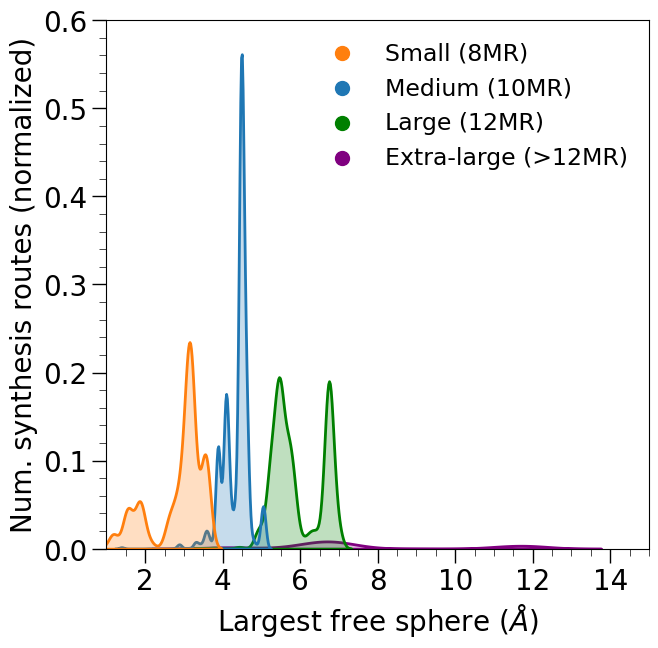

In [13]:
plt.figure(figsize = (7,7), dpi = 100)
sns.kdeplot(data=df, x="largest_free_sphere", hue="pore_type", 
            hue_order=['Small', 'Medium', 'Large', 'Extra-large'] , 
            palette=[s_pore_c, m_pore_c, l_pore_c, xl_pore_c],
            fill = True,
            linewidths=2,
            legend=False)

plt.xlabel('Largest free sphere ($\AA$)', fontsize = 20)
plt.ylabel('Num. synthesis routes (normalized)', fontsize = 20)

# Create legend
handles = [plt.scatter([], [], s = 100, color=s_pore_c,  label='Small (8MR)'),
           plt.scatter([], [], s = 100, color=m_pore_c,  label='Medium (10MR)'),
           plt.scatter([], [], s = 100, color=l_pore_c,  label='Large (12MR)'),
           plt.scatter([], [], s = 100, color=xl_pore_c, label='Extra-large (>12MR)'),
          ]
labels = [handle.get_label() for handle in handles]
plt.legend(handles=handles, labels=labels, fontsize = 17, frameon=0)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20) 

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=1)
plt.tick_params(axis='y', which='minor', length=5, width=0.5)
plt.tick_params(axis='x', which='major', length=10, width=1)
plt.tick_params(axis='x', which='minor', length=5, width=0.5)


plt.xlim(1,15)
plt.ylim(0,0.6)

plt.show()

# Zeotype distribution

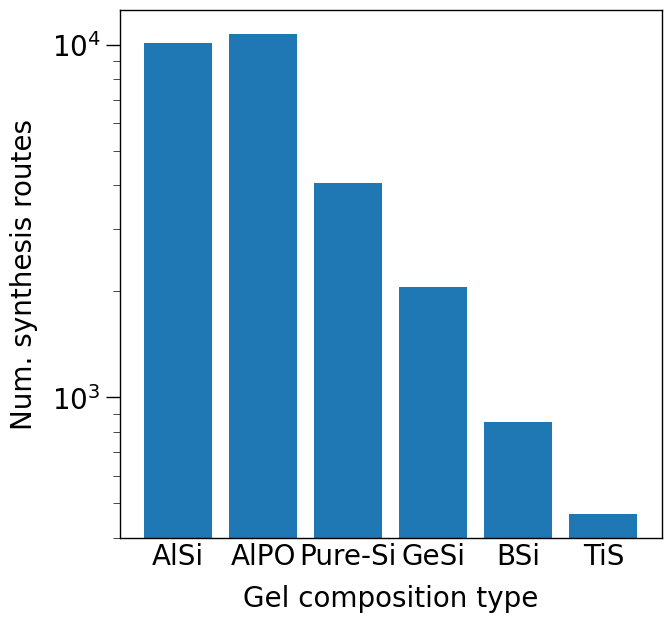

In [14]:
Si = df[(df['Si'] != 0) \
        & (df['Al'] == 0) \
        & (df['P']  == 0) \
        & (df['B']  == 0) \
        & (df['Ti']  == 0) \
        & (df['Ge']  == 0) \
         ]

SiAl = df[(df['Si'] != 0) \
        & (df['Al'] != 0) \
        & (df['P']  == 0) \
        & (df['B']  == 0) \
        & (df['Ti']  == 0) \
        & (df['Ge']  == 0) \
         ]
SiGe = df[
          (df['Si'] != 0) \
        & (df['B']  == 0) \
        & (df['Ti']  == 0) \
        & (df['Ge'] != 0) \
         ]
SiB = df[(df['Si'] != 0) \
        & (df['B']  != 0) \
        & (df['Ti']  == 0) \
        & (df['Ge']  == 0) \
         ]
AlP = df[
         (df['Al'] != 0) \
        & (df['P']  != 0) \
         ]

SiT = df[(df['Si'] != 0) \
        & (df['Al'] == 0) \
        & (df['P']  == 0) \
        & (df['B']  == 0) \
        & (df['Ti']  != 0) \
        & (df['Ge']  == 0) \
         ]

fig, ax = plt.subplots(figsize=(7,7), dpi = 100)

plt.bar(x=['AlSi', 'AlPO', 'Pure-Si','GeSi', 'BSi', 'TiS'], height=[len(SiAl), len(AlP), len(Si), len(SiGe), len(SiB), len(SiT)])
plt.xlabel('Gel composition type', fontsize=20, labelpad=10)
plt.ylabel('Num. synthesis routes', fontsize=20, labelpad=10)
ax.set_yscale('log')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20) 

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(1)    # Top axis line
ax.spines['right'].set_linewidth(1)  # Right axis line
ax.spines['bottom'].set_linewidth(1) # Bottom axis line
ax.spines['left'].set_linewidth(1)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.tick_params(axis='y', which='major', length=10, width=1)
plt.tick_params(axis='y', which='minor', length=5, width=0.5)
plt.tick_params(axis='x', which='major', length=0, width=0)

plt.show()

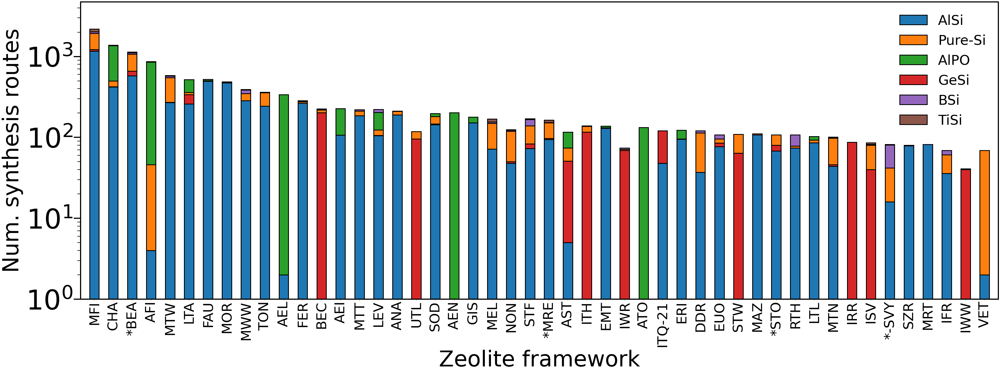

In [15]:
# Zeolite distribution by frequency
n_frameworks = 50
zeos_value_counts = df['Code1'].value_counts()[:n_frameworks]
zeos_value_counts = zeos_value_counts[~zeos_value_counts.index.str.contains('/')]

fig, ax = plt.subplots(figsize=(60,20))

# Create a dictionary of lists, each with len(zeo_value_counts). Each element of this list is the number of zeotypes for a framework
zeotype_counts = {
         'AlSi':    [len(SiAl[SiAl['Code1'] == z]) for z in zeos_value_counts.index], 
         'GeSi':    [len(SiGe[SiGe['Code1'] == z]) for z in zeos_value_counts.index],
         'Pure-Si': [len(Si[Si['Code1'] == z]) for z in zeos_value_counts.index], 
         'AlPO':    [len(AlP[AlP['Code1'] == z]) for z in zeos_value_counts.index],  
         'BSi':     [len(SiB[SiB['Code1'] == z]) for z in zeos_value_counts.index],
         'TiSi':     [len(SiT[SiT['Code1'] == z]) for z in zeos_value_counts.index],
                 }
zeotype_colors = {
         'AlSi':    'tab:blue', 
         'GeSi':    'tab:red',
         'Pure-Si': 'tab:orange', 
         'AlPO':    'tab:green',  
         'BSi':     'tab:purple',
         'TiSi':    'tab:brown',
                 }


# Initialize bottom anchor (to be added onto)
bottom = np.zeros(len(zeos_value_counts))

for zeotype, zeotype_count in zeotype_counts.items():
    p = ax.bar(zeos_value_counts.index, zeotype_count, 0.5, label=zeotype, color = zeotype_colors[zeotype],bottom=bottom, edgecolor='black', linewidth=3)
    bottom += zeotype_count

plt.xlabel('Zeolite framework', fontsize=80, labelpad=10)
plt.ylabel('Num. synthesis routes', fontsize=80, labelpad=10)
ax.set_yscale('log')
plt.xticks(fontsize=50)
plt.yticks(fontsize=100) 

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(4)    # Top axis line
ax.spines['right'].set_linewidth(4)  # Right axis line
ax.spines['bottom'].set_linewidth(4) # Bottom axis line
ax.spines['left'].set_linewidth(4)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=25, width=4)
plt.tick_params(axis='y', which='minor', length=12.5, width=2)

plt.xticks(rotation = 90)

plt.margins(0.01, 0.1)

handles, labels = plt.gca().get_legend_handles_labels() # get handles and labels
legend_colors = dict(zip(labels, handles))
plt.legend([legend_colors['AlSi'], legend_colors['Pure-Si'], legend_colors['AlPO'], legend_colors['GeSi'], legend_colors['BSi'], legend_colors['TiSi'],], ['AlSi', 'Pure-Si', 'AlPO', 'GeSi', 'BSi', 'TiSi'],  
           fontsize = 50, frameon = 0, loc = 'upper right') # add legend to plot

plt.show()

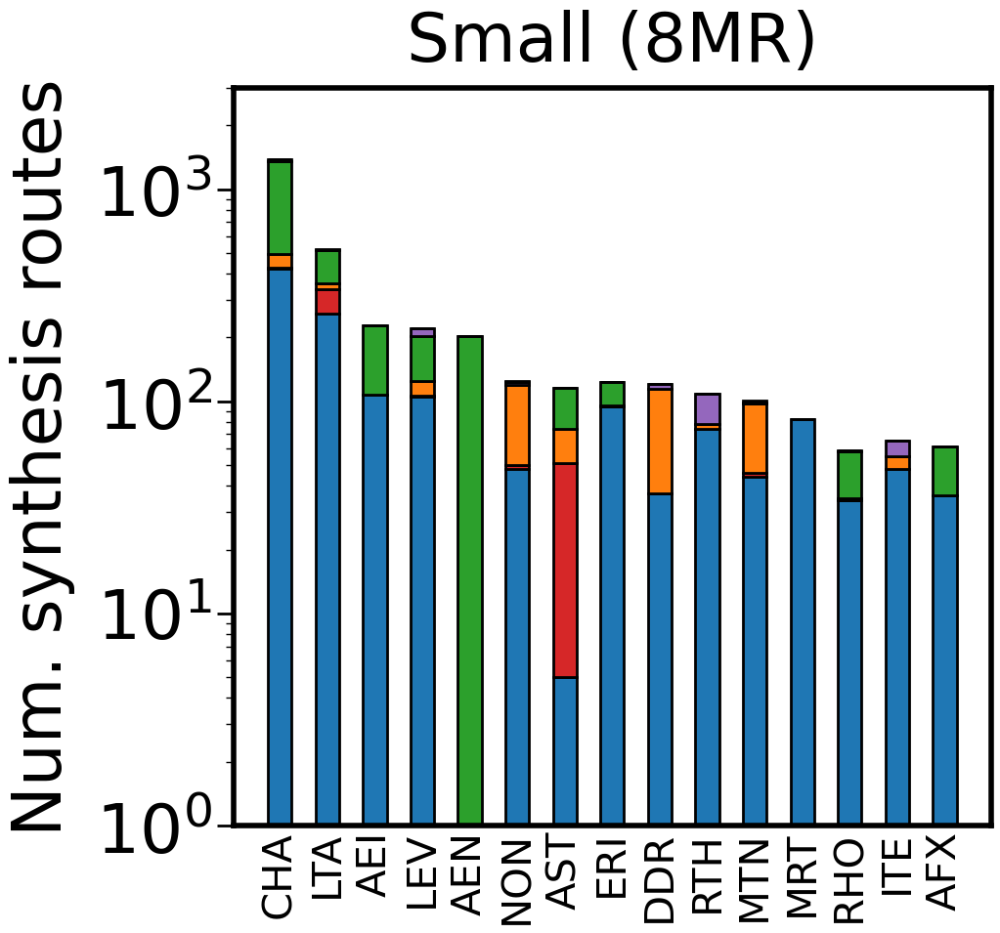

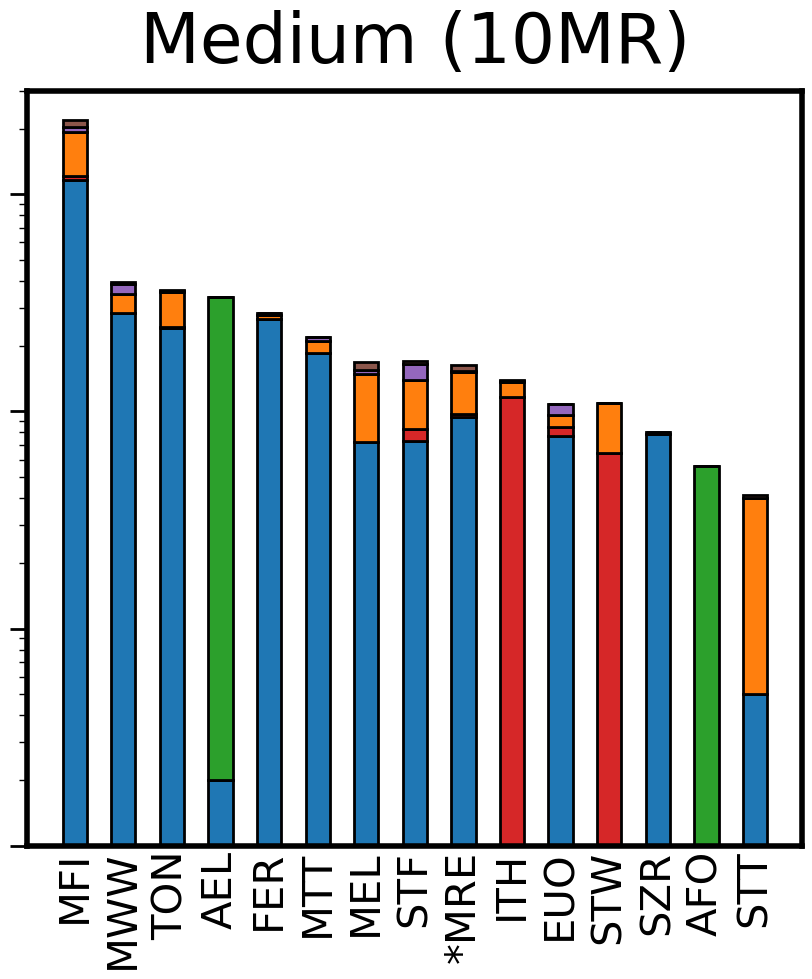

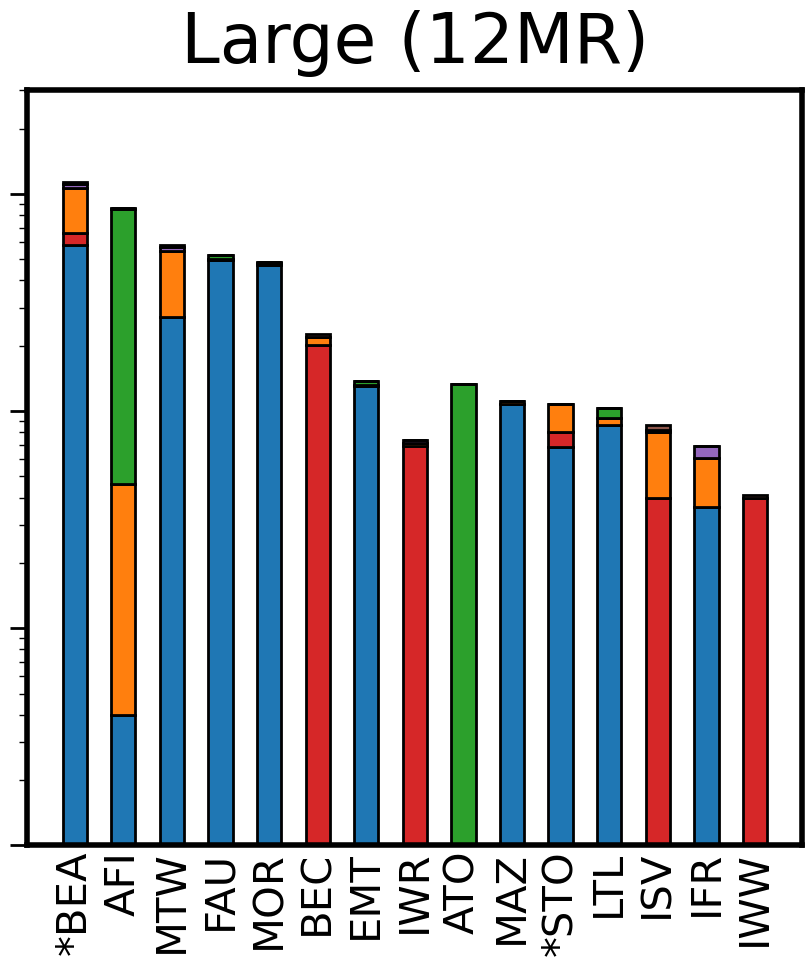

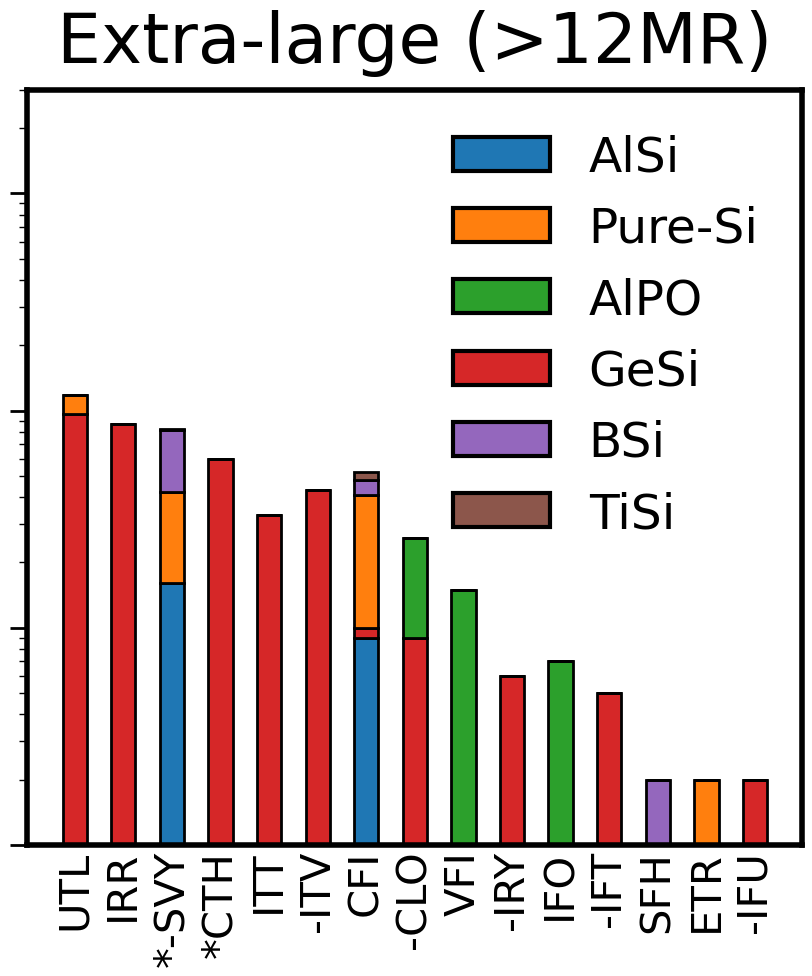

In [16]:
# Zeolite pore distribution by pore size + frequency 
for pore_name, p in zip(['Small (8MR)', 'Medium (10MR)', 'Large (12MR)', 'Extra-large (>12MR)'], [s_pore, m_pore, l_pore, xl_pore]):
    
    if pore_name == 'Small (8MR)':
        n_frameworks = 18 # To remove dense phases ANA, SOD, GIS
    else:
        n_frameworks = 15
    
    zeos_value_counts = df['Code1'].value_counts()
    zeos_value_counts = zeos_value_counts[~zeos_value_counts.index.str.contains('/')]
    zeos_value_counts_pore = zeos_value_counts[zeos_value_counts.index.isin(p)][:n_frameworks]
    
    if pore_name == 'Small (8MR)': # To remove dense phases ANA, SOD, GIS
        zeos_value_counts_pore = zeos_value_counts_pore.drop(index = ['ANA', 'SOD', 'GIS'])

    fig, ax = plt.subplots(figsize=(10,10), dpi = 100)

    # Create a dictionary of lists, each with len(zeo_value_counts). Each element of this list is the number of zeotypes for a framework
    zeotype_counts = {
             'AlSi':    [len(SiAl[SiAl['Code1'] == z]) for z in zeos_value_counts_pore.index], 
             'GeSi':    [len(SiGe[SiGe['Code1'] == z]) for z in zeos_value_counts_pore.index], 
             'Pure-Si': [len(Si[Si['Code1'] == z]) for z in zeos_value_counts_pore.index], 
             'AlPO':    [len(AlP[AlP['Code1'] == z]) for z in zeos_value_counts_pore.index], 
             'BSi':     [len(SiB[SiB['Code1'] == z]) for z in zeos_value_counts_pore.index],
             'TiSi':     [len(SiT[SiT['Code1'] == z]) for z in zeos_value_counts_pore.index],
                     }

    # Initialize bottom anchor (to be added onto)
    bottom = np.zeros(len(zeos_value_counts_pore))

    for zeotype, zeotype_count in zeotype_counts.items():
        p = ax.bar(zeos_value_counts_pore.index, zeotype_count, 0.5, label=zeotype, color = zeotype_colors[zeotype], bottom=bottom, edgecolor='black', linewidth=2)
        bottom += zeotype_count

    if pore_name == 'Small (8MR)':
        plt.ylabel('Num. synthesis routes', fontsize=50, labelpad=15)
    ax.set_yscale('log')
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=50) 

    # Set the line thickness of the axes
    ax.spines['top'].set_linewidth(4)    # Top axis line
    ax.spines['right'].set_linewidth(4)  # Right axis line
    ax.spines['bottom'].set_linewidth(4) # Bottom axis line
    ax.spines['left'].set_linewidth(4)   # Left axis line

    # Set the length and size of major/minor tick marks on the y-axis
    plt.minorticks_on()
    plt.tick_params(axis='y', which='major', length=12.5, width=2)
    plt.tick_params(axis='y', which='minor', length=6, width=1)
    plt.tick_params(axis='x', which='major', length=0, width=1)
    plt.tick_params(axis='x', which='minor', length=0, width=1)
    
    if pore_name != 'Small (8MR)':
        plt.tick_params(labelleft = False)

    plt.xticks(rotation = 90)

    if pore_name == 'Extra-large (>12MR)':
        plt.legend([legend_colors['AlSi'], legend_colors['Pure-Si'], legend_colors['AlPO'], legend_colors['GeSi'], legend_colors['BSi'], legend_colors['TiSi'],], ['AlSi', 'Pure-Si', 'AlPO', 'GeSi', 'BSi', 'TiSi'],  
           fontsize = 35, frameon = 0, loc = 'upper right') # add legend to plot
    plt.title(pore_name, fontsize = 50, pad=20)
    
    plt.ylim(1,3000)

    plt.show()

# Pore type vs time

In [17]:
s_pore_years, m_pore_years, l_pore_years, xl_pore_years             = [], [], [], []
s_pore_num_syns, m_pore_num_syns, l_pore_num_syns, xl_pore_num_syns = [], [], [], []

s_pore_num_syn, m_pore_num_syn, l_pore_num_syn, xl_pore_num_syn = 0, 0, 0, 0
for year in np.arange(1966, 2020):
    
    for y, data in df_s_pore.groupby('year'):
        if y == year:
            s_pore_num_syn += len(data)
            s_pore_years.append(year), s_pore_num_syns.append(s_pore_num_syn)
            
    for y, data in df_m_pore.groupby('year'):
        if y == year:
            m_pore_num_syn += len(data)
            m_pore_years.append(year), m_pore_num_syns.append(m_pore_num_syn)
            
    for y, data in df_l_pore.groupby('year'):
        if y == year:
            l_pore_num_syn += len(data)
            l_pore_years.append(year), l_pore_num_syns.append(l_pore_num_syn)
    
    for y, data in df_xl_pore.groupby('year'):
        if y == year:
            xl_pore_num_syn += len(data)
            xl_pore_years.append(year), xl_pore_num_syns.append(xl_pore_num_syn)

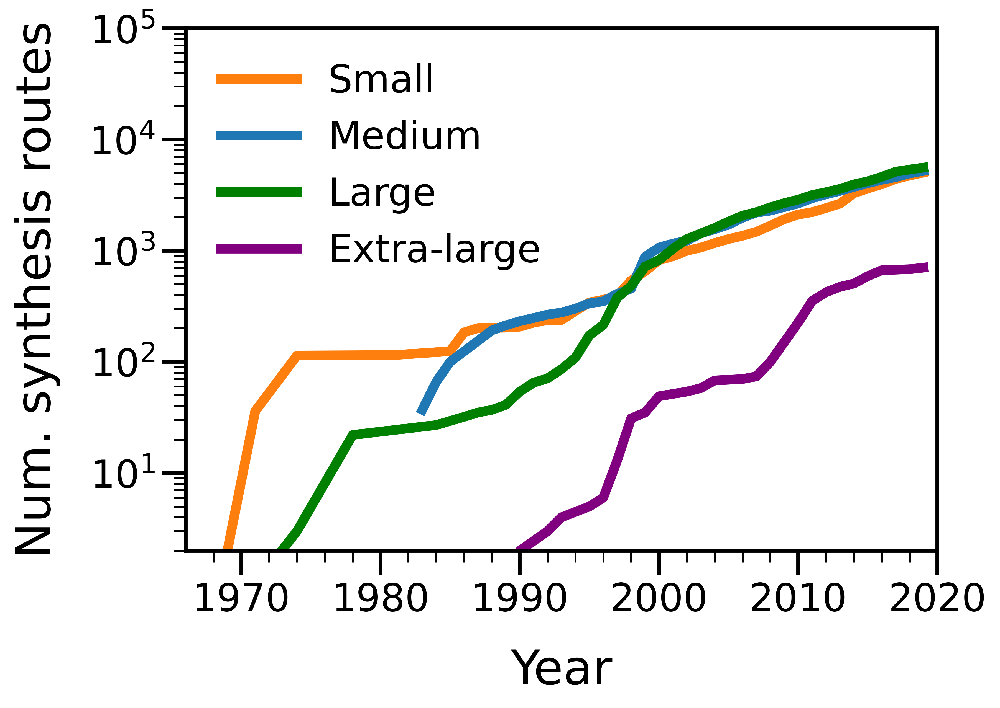

In [18]:
lw = 5
fig, ax = plt.subplots(figsize=(7,5), dpi = 500)
plt.plot(s_pore_years, s_pore_num_syns, label = 'Small', linewidth = lw, c = s_pore_c)
plt.plot(m_pore_years, m_pore_num_syns, label = 'Medium', linewidth = lw, c = m_pore_c)
plt.plot(l_pore_years, l_pore_num_syns, label = 'Large', linewidth = lw, c = l_pore_c)
plt.plot(xl_pore_years, xl_pore_num_syns, label = 'Extra-large', linewidth = lw, c = xl_pore_c)
plt.yscale('log')

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=12.5, width=2)
plt.tick_params(axis='y', which='minor', length=6, width=1)
plt.tick_params(axis='x', which='major', length=12.5, width=2)
plt.tick_params(axis='x', which='minor', length=6, width=1)

plt.xticks(fontsize=20)
plt.yticks(fontsize=20) 

plt.xlabel('Year', fontsize=25, labelpad=15)
plt.ylabel('Num. synthesis routes', fontsize=25, labelpad=15)

plt.legend(fontsize = 20, frameon = 0)
plt.ylim(2,1e5)
plt.xlim(1966,2020)
plt.show()

# Gel composition distributions

In [19]:
# Define disitributions of gel composition variables
SiAl_ratio = df['Si']/df['Al']
SiAl_ratio = SiAl_ratio[(~SiAl_ratio.isna()) & (SiAl_ratio > 0.)]
SiAl_ratio.replace([np.inf], np.nan, inplace=True)
SiAl_ratio.dropna(inplace=True)
SiAl_ratio = np.array(SiAl_ratio)

SiGe_ratio = df['Si']/df['Ge']
SiGe_ratio = SiGe_ratio[(~SiGe_ratio.isna()) & (SiGe_ratio > 0.)]
SiGe_ratio.replace([np.inf], np.nan, inplace=True)
SiGe_ratio.dropna(inplace=True)
SiGe_ratio = np.array(SiGe_ratio)

SiB_ratio = df['Si']/df['B']
SiB_ratio = SiB_ratio[(~SiB_ratio.isna()) & (SiB_ratio > 0.)]
SiB_ratio.replace([np.inf], np.nan, inplace=True)
SiB_ratio.dropna(inplace=True)
SiB_ratio = np.array(SiB_ratio)

SiTi_ratio = df['Si']/df['Ti']
SiTi_ratio = SiTi_ratio[(~SiTi_ratio.isna()) & (SiTi_ratio > 0.)]
SiTi_ratio.replace([np.inf], np.nan, inplace=True)
SiTi_ratio.dropna(inplace=True)
SiTi_ratio = np.array(SiTi_ratio)

AlP_ratio = df['Al']/df['P']
AlP_ratio = AlP_ratio[(~AlP_ratio.isna()) & (AlP_ratio > 0.)]
AlP_ratio.replace([np.inf], np.nan, inplace=True)
AlP_ratio.dropna(inplace=True)
AlP_ratio = np.array(AlP_ratio)

OHT_ratio = df['OH']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
OHT_ratio = OHT_ratio[(~OHT_ratio.isna()) & (OHT_ratio > 0.)]
OHT_ratio.replace([np.inf], np.nan, inplace=True)
OHT_ratio.dropna(inplace=True)
OHT_ratio = np.array(OHT_ratio)

FT_ratio = df['F']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
FT_ratio = FT_ratio[(~FT_ratio.isna()) & (FT_ratio > 0.)]
FT_ratio.replace([np.inf], np.nan, inplace=True)
FT_ratio.dropna(inplace=True)
FT_ratio = np.array(FT_ratio)

LiT_ratio = df['Li']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
LiT_ratio = LiT_ratio[(~LiT_ratio.isna()) & (LiT_ratio > 0.)]
LiT_ratio.replace([np.inf], np.nan, inplace=True)
LiT_ratio.dropna(inplace=True)
LiT_ratio = np.array(LiT_ratio)

NaT_ratio = df['Na']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
NaT_ratio = NaT_ratio[(~NaT_ratio.isna()) & (NaT_ratio > 0.)]
NaT_ratio.replace([np.inf], np.nan, inplace=True)
NaT_ratio.dropna(inplace=True)
NaT_ratio = np.array(NaT_ratio)

KT_ratio = df['K']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
KT_ratio = KT_ratio[(~KT_ratio.isna()) & (KT_ratio > 0.)]
KT_ratio.replace([np.inf], np.nan, inplace=True)
KT_ratio.dropna(inplace=True)
KT_ratio = np.array(KT_ratio)

OSDAT_ratio = df['sda1']/df[['Si','Al','P','Ge','B','V','Be','Ga','Ti']].sum(1)
OSDAT_ratio = OSDAT_ratio[(~OSDAT_ratio.isna()) & (OSDAT_ratio > 0.)]
OSDAT_ratio.replace([np.inf], np.nan, inplace=True)
OSDAT_ratio.dropna(inplace=True)
OSDAT_ratio = np.array(OSDAT_ratio)

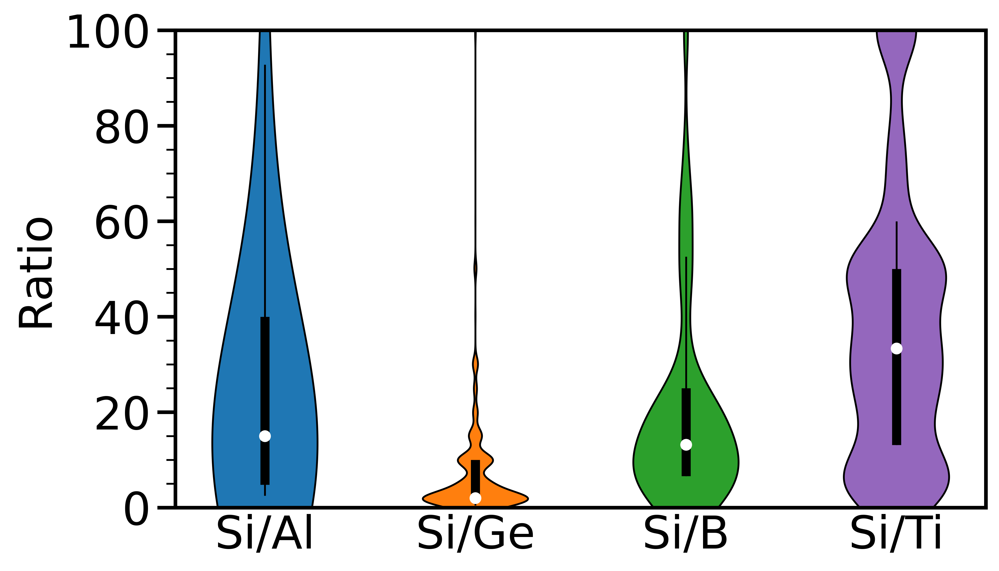

In [20]:
# Heteroatom distributions
data     = [SiAl_ratio, SiGe_ratio, SiB_ratio, SiTi_ratio]
x_labels = ['Si/Al', 'Si/Ge', 'Si/B', 'Si/Ti']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 500)

parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=5000,
        bw_method=0.125,
)

colors = ['tab:blue', 'tab:orange', 'tab:green','tab:purple']
for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)

plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 

plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(0,100)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

plt.ylabel('Ratio', fontsize = 25)

plt.show()

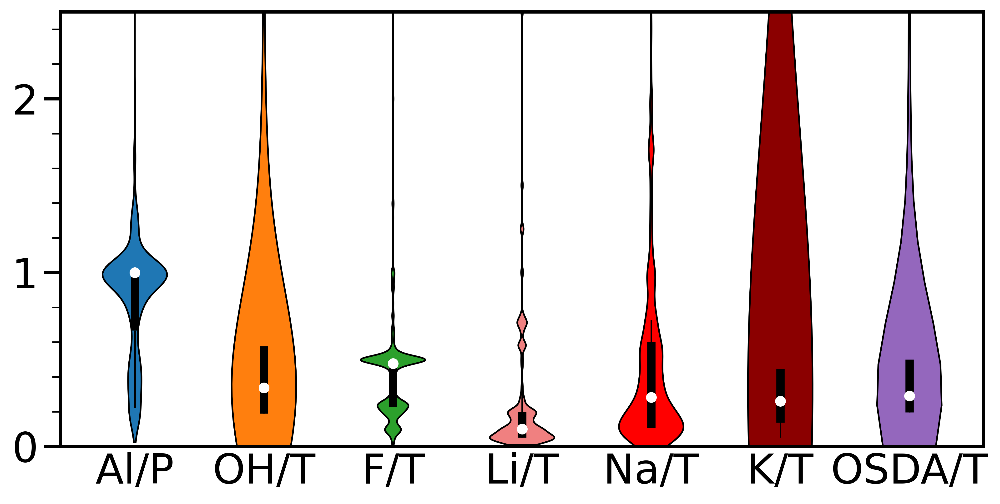

In [21]:
# Mineralizing agents, metal cation distributions
data     = [AlP_ratio, OHT_ratio, FT_ratio, LiT_ratio, NaT_ratio, KT_ratio, OSDAT_ratio]
x_labels = ['Al/P', 'OH/T', 'F/T', 'Li/T', 'Na/T', 'K/T', 'OSDA/T']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 5), dpi = 500)

parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=5000,
        bw_method=0.05,
)

colors = ['tab:blue', 'tab:orange', 'tab:green', 'lightcoral', 'red', 'darkred' ,'tab:purple']
for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)

plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 

plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(0,2.5)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

# Set the x-tick interval
plt.yticks(np.arange(0, 3, 1.))

plt.show()

# Cryst temp w.r.t. zeotype

In [22]:
cryst_temp = df['cryst_temp']
cryst_temp = cryst_temp.apply(lambda x: float(x) if type(x) == int else x) # Int to float
cryst_temp= cryst_temp.apply(lambda x: float(x.split('(')[0]) if type(x) == str else x) # Convert A(B) to A where A and B are numbers
cryst_temp = (cryst_temp[(~cryst_temp.isna())])

cryst_temp_SiAl = list(cryst_temp[cryst_temp.index.isin(SiAl.index)])
cryst_temp_SiGe = list(cryst_temp[cryst_temp.index.isin(SiGe.index)])
cryst_temp_SiB = list(cryst_temp[cryst_temp.index.isin(SiB.index)])
cryst_temp_SiT = list(cryst_temp[cryst_temp.index.isin(SiT.index)])
cryst_temp_AlP = list(cryst_temp[cryst_temp.index.isin(AlP.index)])

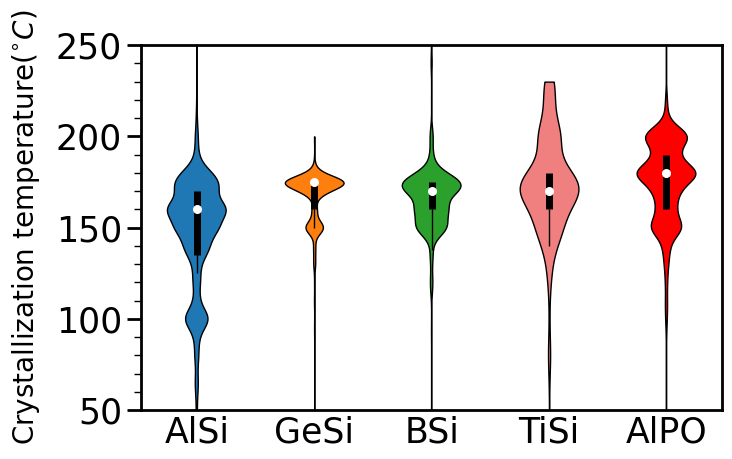

In [23]:
# Crystallization temperature distributions across different chemistries
data     = [cryst_temp_SiAl, cryst_temp_SiGe, cryst_temp_SiB, cryst_temp_SiT, cryst_temp_AlP]
x_labels = ['AlSi', 'GeSi', 'BSi', 'TiSi', 'AlPO']
colors = ['tab:blue', 'tab:orange', 'tab:green', 'lightcoral', 'red', 'darkred' ,'tab:purple']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7.5, 5), dpi = 100)


parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=1000,
)

for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)

plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 

plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(50,250)

plt.ylabel('Crystallization temperature($^{\circ}C$)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

# Set the x-tick interval
plt.yticks(np.arange(50, 300, 50))

plt.show()

# Element distributions

In [24]:
elem_cols = [
'Si', 'Al', 'P', 'Na', 'K', 'Li',
'Sr', 'Rb', 'Cs', 'Ba', 'Ca', 'F', 'Ge', 'Ti', 'In', 'B', 'Mg', 'Ga', 
'Ni', 'Mn', 'Fe', 'Co', 'Cr', 'Zn', 'Nb', 'Be', 'W', 'Ce', 'Cu', 'Sn', 'Gd', 'La', 'Y', 'Dy', 'Sm', 'Ag', 'Cd', 'Zr', 'V',
'Ta', 'Ru', 'Hf', 'Yb', 'Tl', 'As',
]

elem_freq = {}
freqs = []
for elem in elem_cols:
    freq = np.log10(len(df[(~df[elem].isna()) & (df[elem]>0)]))
    elem_freq[elem] = freq

/home/jupyter/Elton/Zeolites/ZeoSyn_dataset_paper/s4/ml/plotting.py:182: MatplotlibDeprecationWarning: You are modifying the state of a globally registered colormap. This has been deprecated since 3.3 and in 3.6, you will not be able to modify a registered colormap in-place. To remove this warning, you can make a copy of the colormap first. cmap = mpl.cm.get_cmap("coolwarm").copy()
  cbar.cmap.set_under(blank_color)


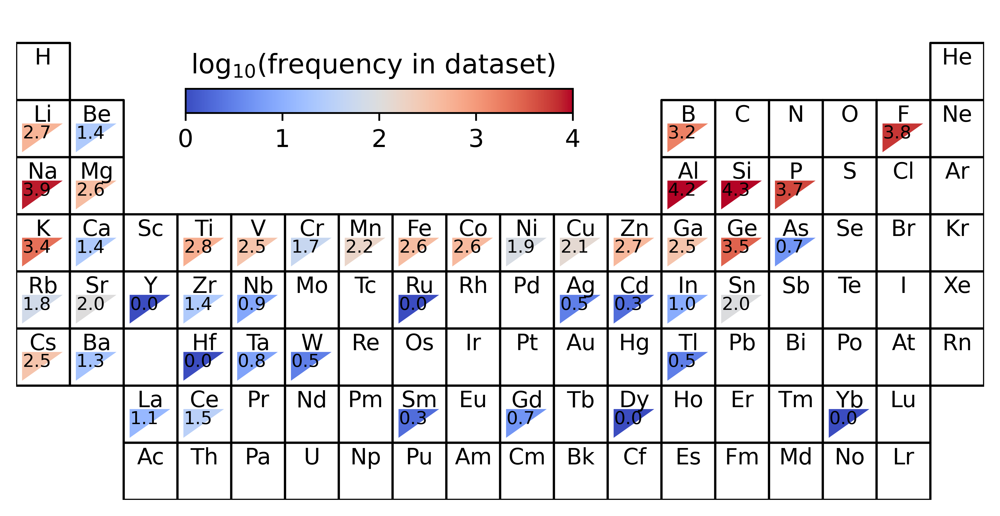

In [25]:
# Generate periodic table of element frequencies
fig = plt.figure(figsize=(6, 3), dpi=600)

ax1_pt = fig.add_axes([0., 0., 1., 1.])
ax1_cbar = fig.add_axes([0.175, 0.8, 0.4, 0.05])

periodic_table_heatmap_sbs(
    {x.split('[')[0].split('_')[-1]: y
     for x, y in elem_freq.items() 
    },
    {x.split('[')[0].split('_')[-1]: y
     for x, y in {}.items() 
     },
    cmap='coolwarm',
    cax=ax1_cbar,
    cbar_label_size=11,
    value_format='\n%.1f',
    include_rows={1,2,3,4,5,6,8,9},
    ax=ax1_pt,
    pt_label_fontsize=10,
    pt_value_fontsize=8,
    cmap_range=(0, 4),
)
ax1_pt.text(3.25, 0.8, 'log$_{10}$(frequency in dataset)', fontsize=12)

ax_labels = fig.add_axes([0, 0, 1, 1])
ax_labels.patch.set_alpha(0.0)
ax_labels.set_xlim([0, 1])
ax_labels.set_ylim([0, 1])
ax_labels.set_xticks([])
ax_labels.set_yticks([])
[v.set_visible(False) for v in ax_labels.spines.values()]

plt.show()

# Crystallization temp w.r.t. pore type

In [26]:
cryst_temp_s_pore = list(cryst_temp[cryst_temp.index.isin(df[df['pore_type'] == 'Small'].index)])
cryst_temp_m_pore = list(cryst_temp[cryst_temp.index.isin(df[df['pore_type'] == 'Medium'].index)])
cryst_temp_l_pore = list(cryst_temp[cryst_temp.index.isin(df[df['pore_type'] == 'Large'].index)])
cryst_temp_xl_pore = list(cryst_temp[cryst_temp.index.isin(df[df['pore_type'] == 'Extra-large'].index)])

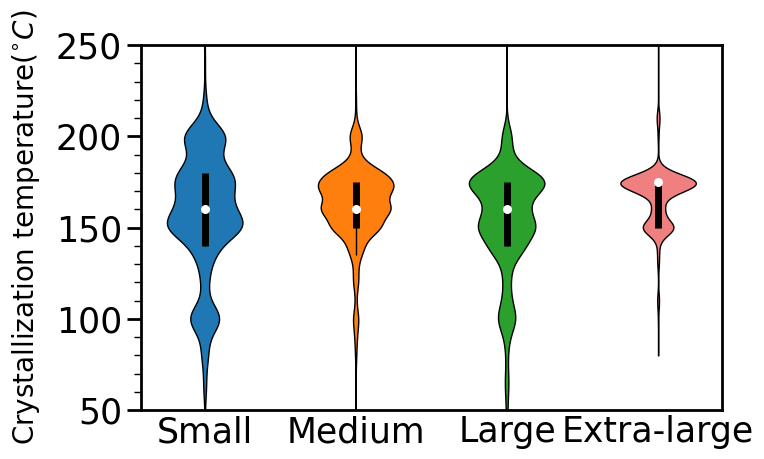

In [27]:
# Crystallization temperature distributions across different pore sizes
data     = [cryst_temp_s_pore, cryst_temp_m_pore, cryst_temp_l_pore, cryst_temp_xl_pore]
x_labels = ['Small', 'Medium', 'Large', 'Extra-large']
colors = ['tab:blue', 'tab:orange', 'tab:green', 'lightcoral', 'red', 'darkred' ,'tab:purple']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7.5, 5), dpi = 100)


parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=1000,
)

for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)

plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 

plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(50,250)

plt.ylabel('Crystallization temperature($^{\circ}C$)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

# Set the x-tick interval
plt.yticks(np.arange(50, 300, 50))

plt.show()

# Crystallization temp w.r.t. framework density

In [28]:
df['cryst_temp'] = df['cryst_temp'].apply(lambda x: float(x) if type(x) == int else x) # Int to float
df['cryst_temp'] = df['cryst_temp'].apply(lambda x: float(x.split('(')[0]) if type(x) == str else x) # Convert A(B) to A where A and B are numbers

cryst_temp_fwd = df[['cryst_temp', 'framework_density', 'Code1']]
cryst_temp_fwd['cryst_temp'] = (cryst_temp_fwd['cryst_temp'][(~cryst_temp_fwd['cryst_temp'].isna())])
cryst_temp_fwd = cryst_temp_fwd.dropna()

/home/synthesisproject/anaconda3/envs/zeo_classification/lib/python3.7/site-packages/pandas/core/frame.py:3607: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._set_item(key, value)


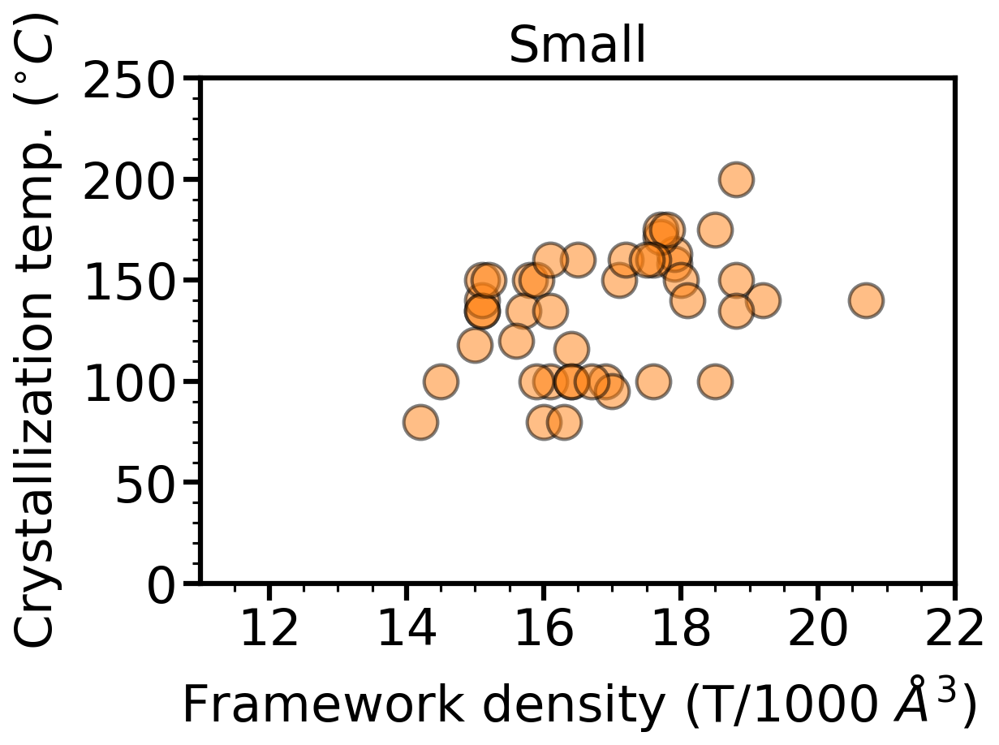

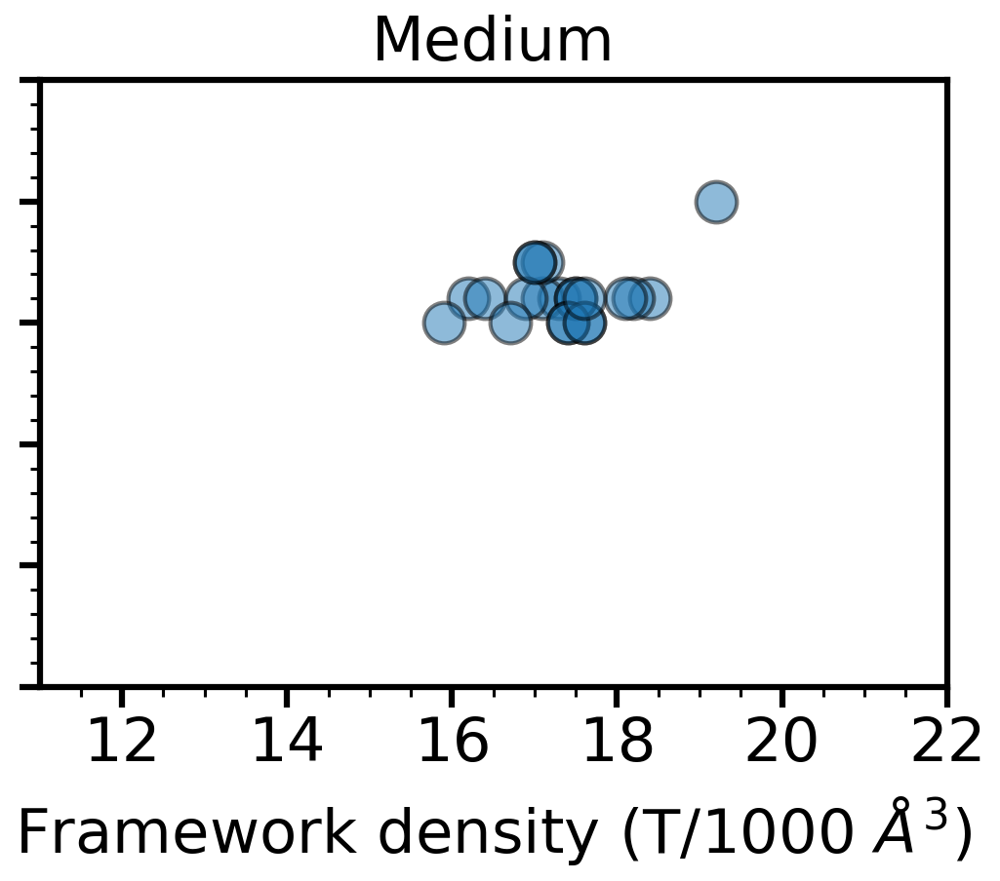

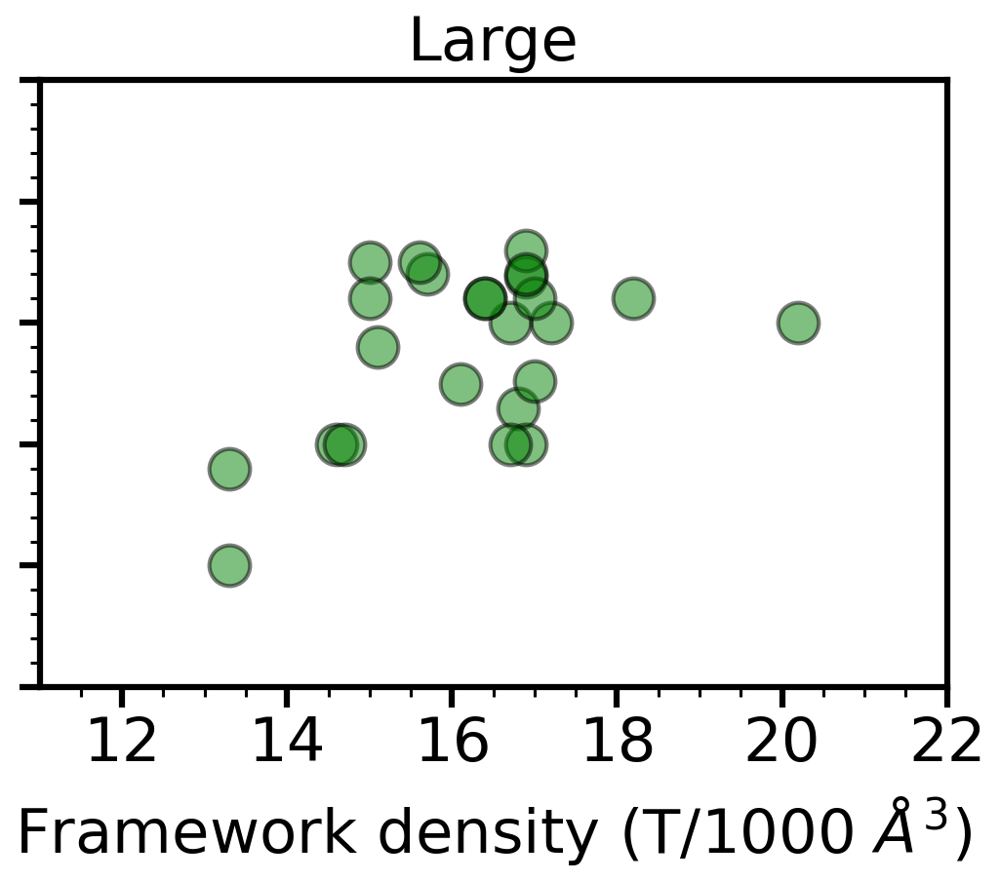

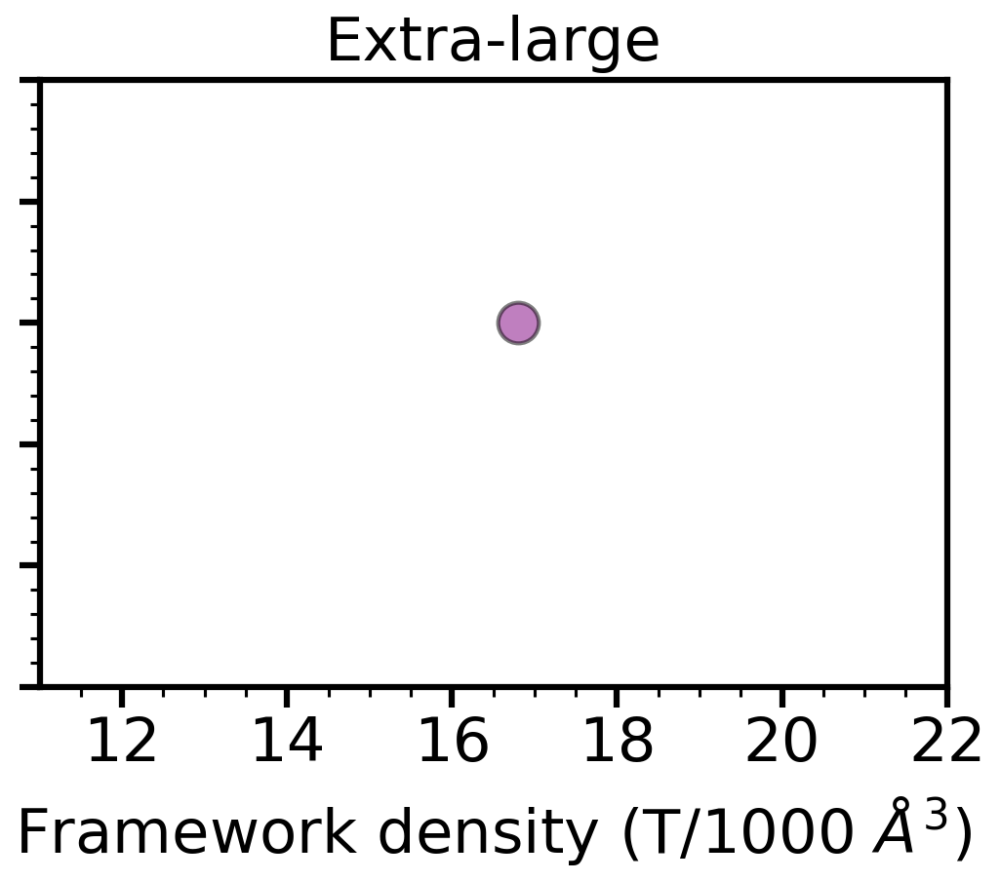

In [29]:
fwds = []
cryst_temps = []
zeos = []

for zeo, data in cryst_temp_fwd[cryst_temp_fwd.index.isin(SiAl.index)].groupby('Code1'):
    
    fwds.append(data['framework_density'].iloc[0]) # take first instance since framework density is the same for all datapoints in grouby
    cryst_temps.append(data['cryst_temp'].quantile(q=0.3)) # take nth quantile of temperature
    zeos.append(zeo)

cryst_temp_fwd_zeo = pd.DataFrame()
cryst_temp_fwd_zeo['framework_density'],  cryst_temp_fwd_zeo['cryst_temp'], cryst_temp_fwd_zeo['Code1'] = fwds, cryst_temps, zeos


for pore, color, pore_name in zip([s_pore, m_pore, l_pore, xl_pore], [s_pore_c, m_pore_c, l_pore_c, xl_pore_c], ['Small', 'Medium', 'Large', 'Extra-large']):
    data = cryst_temp_fwd_zeo[cryst_temp_fwd_zeo['Code1'].isin(pore)]
    
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5.5), dpi = 150)

    plt.scatter(data['framework_density'], data['cryst_temp'], s = 400, alpha = 0.5, color = color, edgecolor = 'black', linewidth = 2)

    plt.yticks(fontsize=30) 
    plt.xticks(fontsize=30) 

    plt.ylabel('Crystallization temp. ($^{\circ}C$)', fontsize=30, labelpad=10)
    plt.xlabel('Framework density (T/1000 $\AA^3$)', fontsize=30, labelpad=10)
    plt.title('{}'.format(pore_name), fontsize = 30, pad = 10)

    # Set the line thickness of the axes
    ax.spines['top'].set_linewidth(3)    # Top axis line
    ax.spines['right'].set_linewidth(3)  # Right axis line
    ax.spines['bottom'].set_linewidth(3) # Bottom axis line
    ax.spines['left'].set_linewidth(3)   # Left axis line

    # Set the length and size of major/minor tick marks on the y-axis
    plt.minorticks_on()
    plt.tick_params(axis='y', which='major', length=10, width=3)
    plt.tick_params(axis='y', which='minor', length=5, width=1.5)
    plt.tick_params(axis='x', which='major', length=10, width=3)
    plt.tick_params(axis='x', which='minor', length=5, width=1.5)

    plt.xlim(11,22)
    plt.ylim(50,220)
    
    plt.yticks(np.arange(0, 300, 50.))
    
    if pore_name != 'Small':
        plt.ylabel('')
        plt.tick_params(labelleft = False)

    plt.show()

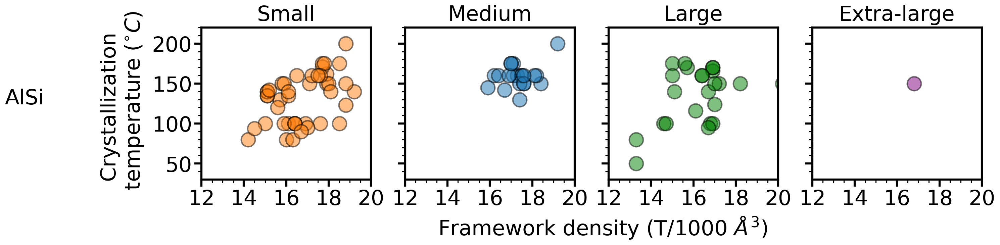

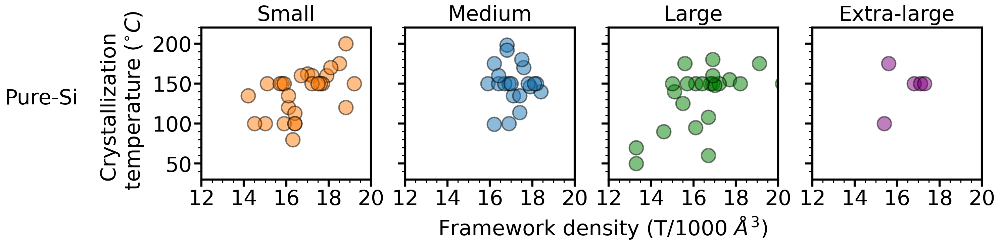

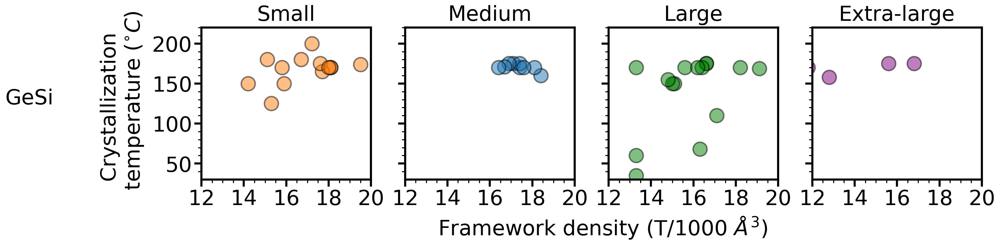

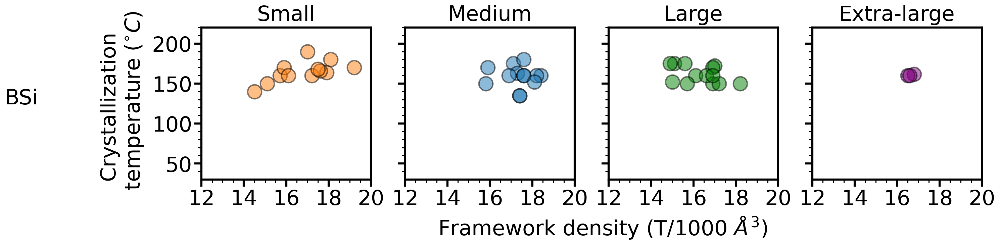

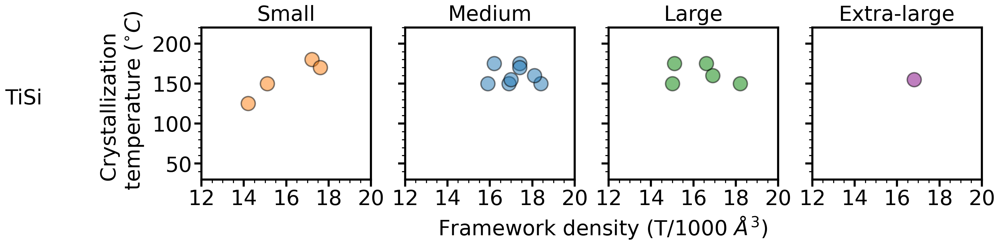

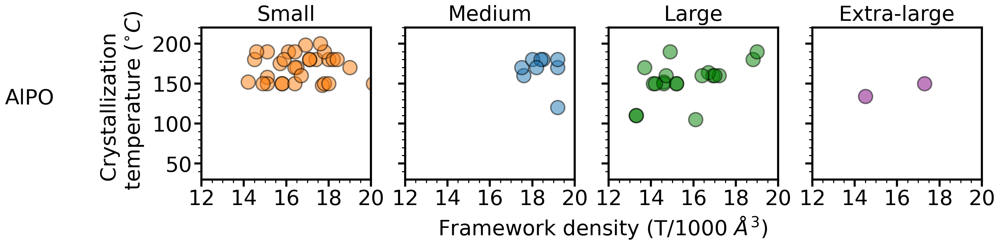

In [30]:
quantile = 0.2 # quantile for taking temperature for a framework

for zeotype, zeotype_name in zip([SiAl, 
                                  Si, 
                                  SiGe, 
                                  SiB, 
                                  SiT, 
                                  AlP], 
                                 ['AlSi', 
                                  'Pure-Si', 
                                  'GeSi', 
                                  'BSi', 
                                  'TiSi', 
                                  'AlPO']
                                ):
    
    fwds = []
    cryst_temps = []
    zeos = []

    for zeo, data in cryst_temp_fwd[cryst_temp_fwd.index.isin(zeotype.index)].groupby('Code1'):

        fwds.append(data['framework_density'].iloc[0]) # take first instance since framework density is the same for all datapoints in grouby
        cryst_temps.append(data['cryst_temp'].quantile(q=quantile)) # take nth quantile of temperature
        zeos.append(zeo)

    cryst_temp_fwd_zeo = pd.DataFrame()
    cryst_temp_fwd_zeo['framework_density'],  cryst_temp_fwd_zeo['cryst_temp'], cryst_temp_fwd_zeo['Code1'] = fwds, cryst_temps, zeos

    fig = plt.figure(figsize=(20, 4), dpi = 150)

    for idx, pore, color, pore_name in zip([1,2,3,4], [s_pore, m_pore, l_pore, xl_pore], [s_pore_c, m_pore_c, l_pore_c, xl_pore_c], ['Small', 'Medium', 'Large', 'Extra-large']):
        data = cryst_temp_fwd_zeo[cryst_temp_fwd_zeo['Code1'].isin(pore)]


        fig.add_subplot(1,4,idx)

        plt.scatter(data['framework_density'], data['cryst_temp'], s = 400, alpha = 0.5, color = color, edgecolor = 'black', linewidth = 2)

        plt.yticks(fontsize=30) 
        plt.xticks(fontsize=30) 

        plt.ylabel('Crystallization \n temperature ($^{\circ}C$)', fontsize=30, labelpad=10)
        plt.title('{}'.format(pore_name), fontsize = 30, pad = 10)

        ax = plt.gca()
        # Set the line thickness of the axes
        ax.spines['top'].set_linewidth(3)    # Top axis line
        ax.spines['right'].set_linewidth(3)  # Right axis line
        ax.spines['bottom'].set_linewidth(3) # Bottom axis line
        ax.spines['left'].set_linewidth(3)   # Left axis line

        # Set the length and size of major/minor tick marks on the y-axis
        plt.minorticks_on()
        plt.tick_params(axis='y', which='major', length=10, width=3)
        plt.tick_params(axis='y', which='minor', length=5, width=1.5)
        plt.tick_params(axis='x', which='major', length=10, width=3)
        plt.tick_params(axis='x', which='minor', length=5, width=1.5)


        plt.yticks(np.arange(0, 300, 50.))
        plt.xticks(np.arange(0, 30, 2.))
        
        plt.xlim(12,20)
        plt.ylim(30,220)

        if pore_name != 'Small':
            plt.ylabel('')
            plt.tick_params(labelleft = False)
    
    plt.gcf().text(-0.07, 0.5, zeotype_name, fontsize=30)
    plt.gcf().text(0.36, -0.15, 'Framework density (T/1000 $\AA^3$)', fontsize=30)

    plt.show()

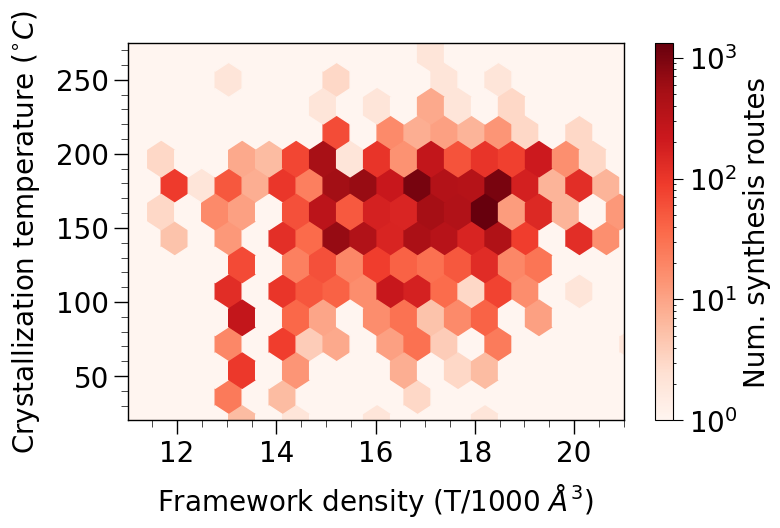

In [31]:
# Aggregated
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 100)

hb = plt.hexbin(x = cryst_temp_fwd['framework_density'] , y= cryst_temp_fwd['cryst_temp'], 
           bins = 'log',
           gridsize = 25,
           cmap = 'Reds')

cb = fig.colorbar(hb, ax=ax)
cb.ax.tick_params(labelsize=20, size=7.5)
cb.set_label('Num. synthesis routes', fontsize = 20)

plt.yticks(fontsize=20) 
plt.xticks(fontsize=20) 

plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
plt.xlabel('Framework density (T/1000 $\AA^3$)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(1)    # Top axis line
ax.spines['right'].set_linewidth(1)  # Right axis line
ax.spines['bottom'].set_linewidth(1) # Bottom axis line
ax.spines['left'].set_linewidth(1)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=1)
plt.tick_params(axis='y', which='minor', length=5, width=0.5)
plt.tick_params(axis='x', which='major', length=10, width=1)
plt.tick_params(axis='x', which='minor', length=5, width=0.5)

plt.xlim(11,21)
plt.ylim(20,275)

plt.show()

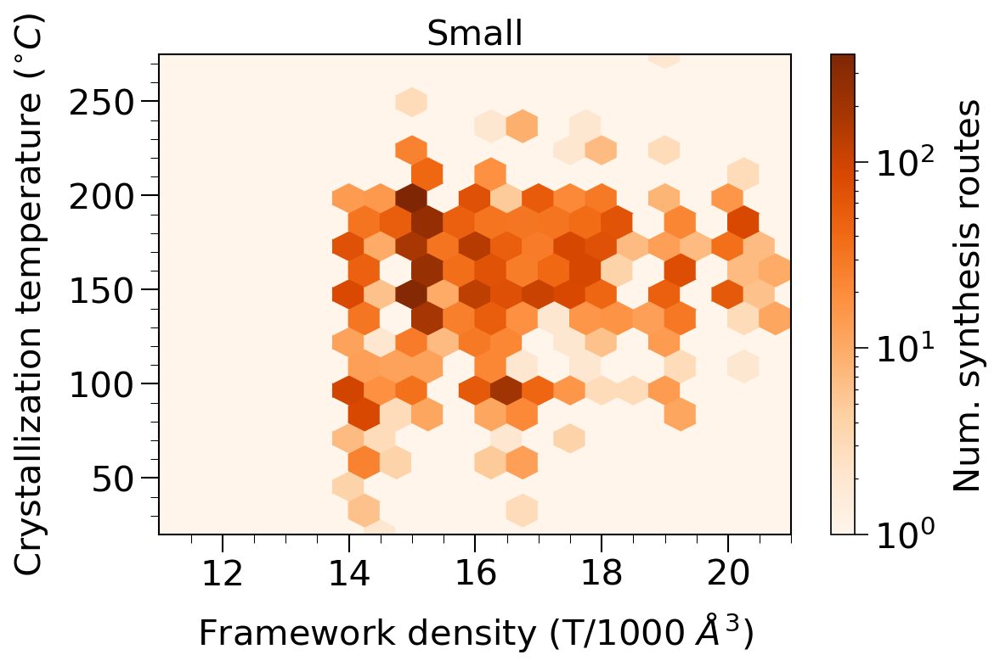

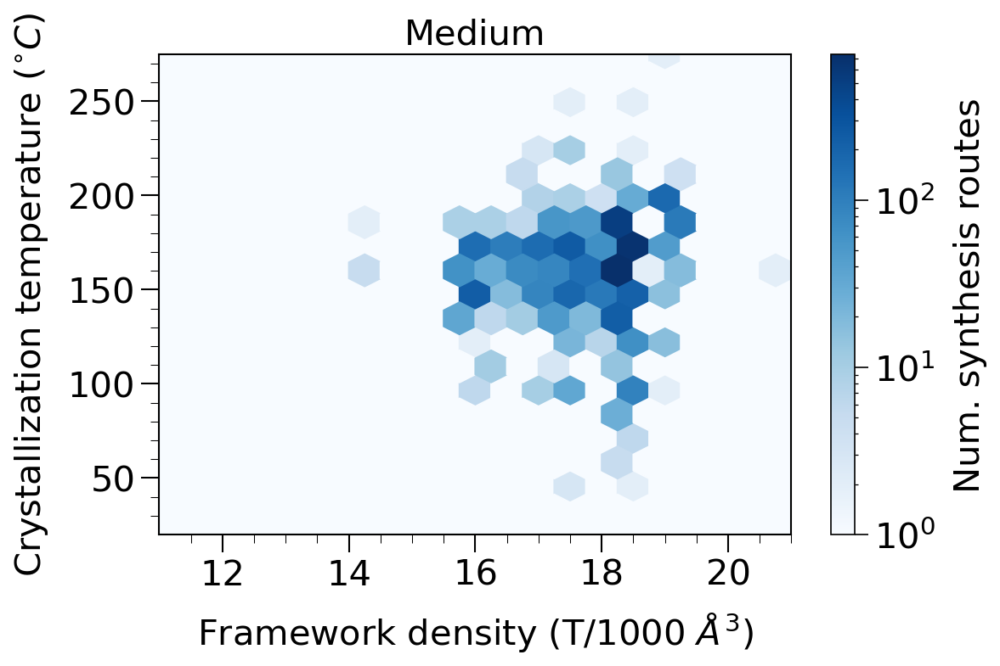

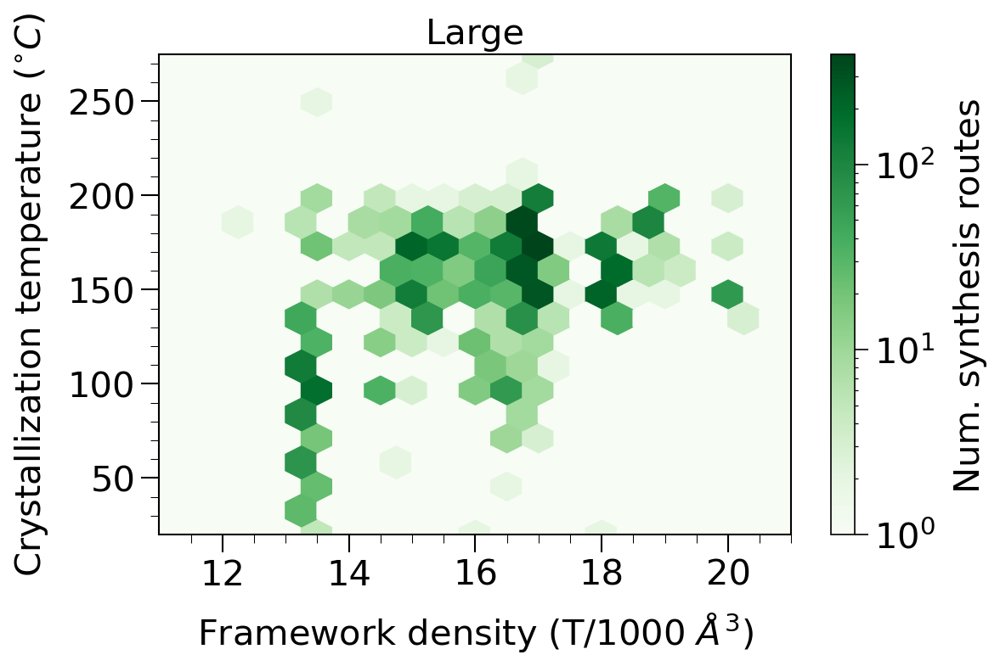

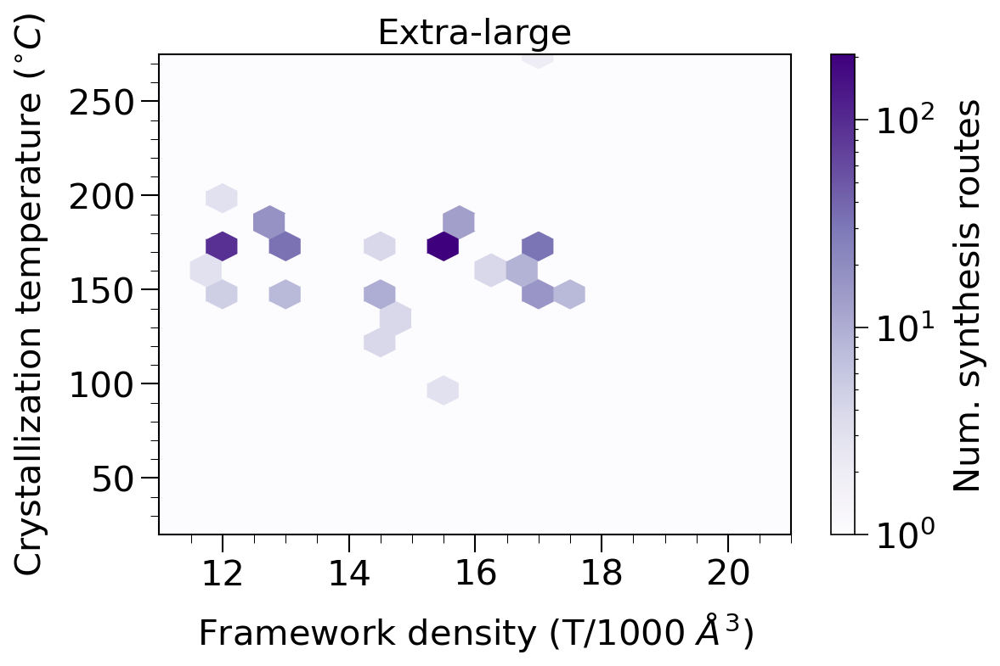

In [32]:
# Cryst_temp vs. FWD for each pore class
pore_classes = ['Small', 'Medium', 'Large', 'Extra-large']
pore_dfs     = [df_s_pore, df_m_pore, df_l_pore, df_xl_pore]
colors       = [s_pore_c, m_pore_c, s_pore_c, m_pore_c]

for pore_class, pore_df in zip(pore_classes, pore_dfs):
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 150)
    
    data = cryst_temp_fwd.loc[cryst_temp_fwd.index.isin(pore_df.index)] # Select synthesis of only a certain pore type
    
    if pore_class=='Small':
        cmap = 'Oranges'
    elif pore_class=='Medium':
        cmap = 'Blues'
    elif pore_class=='Large':
        cmap = 'Greens'
    elif pore_class=='Extra-large':
        cmap = 'Purples'
    
    hb = plt.hexbin(x = data['framework_density'] , y= data['cryst_temp'], 
               bins = 'log',
               gridsize = [20,10],
               cmap = cmap,
               extent=[11, 21, 20, 275] # xy limits for hexbin density
                   )

    cb = fig.colorbar(hb, ax=ax)
    cb.ax.tick_params(labelsize=20, size=7.5)
    cb.set_label('Num. synthesis routes', fontsize = 20, labelpad = 10)

    plt.yticks(fontsize=20) 
    plt.xticks(fontsize=20) 

    plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
    plt.xlabel('Framework density (T/1000 $\AA^3$)', fontsize=20, labelpad=10)
    plt.title('{}'.format(pore_class), fontsize = 20)

    # Set the line thickness of the axes
    ax.spines['top'].set_linewidth(1)    # Top axis line
    ax.spines['right'].set_linewidth(1)  # Right axis line
    ax.spines['bottom'].set_linewidth(1) # Bottom axis line
    ax.spines['left'].set_linewidth(1)   # Left axis line

    # Set the length and size of major/minor tick marks on the y-axis
    plt.minorticks_on()
    plt.tick_params(axis='y', which='major', length=10, width=1)
    plt.tick_params(axis='y', which='minor', length=5, width=0.5)
    plt.tick_params(axis='x', which='major', length=10, width=1)
    plt.tick_params(axis='x', which='minor', length=5, width=0.5)

    plt.xlim(11,21)
    plt.ylim(20,275)

    plt.show()

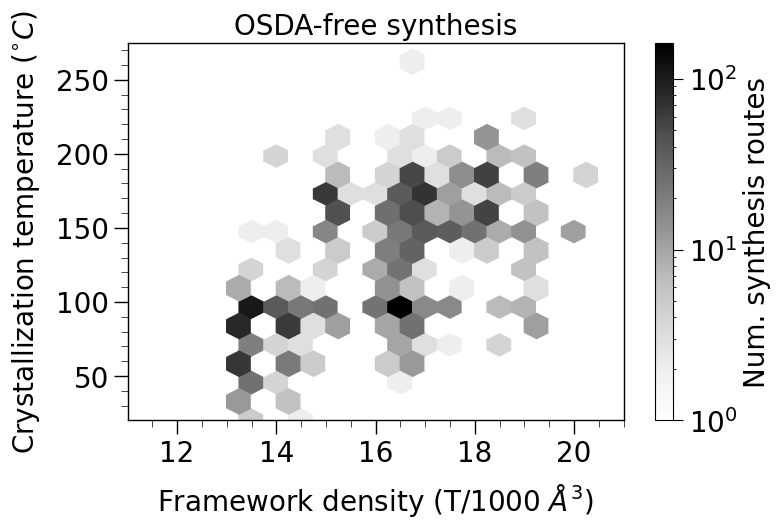

In [33]:
# OSDA-free synthesis, since some cryst temp are above 230 C, where OSDA will decompose
df_osda_free = df[(df['osda1 smiles'].isna()) & (~df['doi'].isna()) & (~df['Code1'].isna())]

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 100)

data = cryst_temp_fwd.loc[cryst_temp_fwd.index.isin(df_osda_free.index)]
hb = plt.hexbin(x = data['framework_density'] , y= data['cryst_temp'], 
           bins = 'log',
           gridsize = [20,10],
           cmap = 'Greys',
           extent=[11, 21, 20, 275] # xy limits for hexbin density
               )

cb = fig.colorbar(hb, ax=ax)
cb.ax.tick_params(labelsize=20, size=7.5)
cb.set_label('Num. synthesis routes', fontsize = 20)

plt.yticks(fontsize=20) 
plt.xticks(fontsize=20) 

plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
plt.xlabel('Framework density (T/1000 $\AA^3$)', fontsize=20, labelpad=10)
plt.title('OSDA-free synthesis', fontsize = 20)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(1)    # Top axis line
ax.spines['right'].set_linewidth(1)  # Right axis line
ax.spines['bottom'].set_linewidth(1) # Bottom axis line
ax.spines['left'].set_linewidth(1)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=1)
plt.tick_params(axis='y', which='minor', length=5, width=0.5)
plt.tick_params(axis='x', which='major', length=10, width=1)
plt.tick_params(axis='x', which='minor', length=5, width=0.5)

plt.xlim(11,21)
plt.ylim(20,275)

plt.show()

# Crystallization time w.r.t zeotype

In [34]:
# Cleaning cryst_time column - some integers and str
df['cryst_time'] = df['cryst_time'].apply(lambda x: float(x) if type(x) == int else (0 if x == "\\" else x)) # Int to float and fix '\' entry
df['cryst_time'] = df['cryst_time'].apply(lambda x: float(x.split('(')[0]) if type(x) == str else x) # Convert A(B) to A where A and B are numbers

cryst_time = df['cryst_time']
cryst_time = cryst_time.apply(lambda x: float(x) if type(x) == int else x) # Int to float
cryst_time = cryst_time.apply(lambda x: float(x.split('(')[0]) if type(x) == str else x) # Convert A(B) to A where A and B are numbers
cryst_time = (cryst_time[(~cryst_time.isna())])

cryst_time_SiAl = list(cryst_time[cryst_time.index.isin(SiAl.index)])
cryst_time_SiGe = list(cryst_time[cryst_time.index.isin(SiGe.index)])
cryst_time_SiB = list(cryst_time[cryst_time.index.isin(SiB.index)])
cryst_time_SiT = list(cryst_time[cryst_time.index.isin(SiT.index)])
cryst_time_AlP = list(cryst_time[cryst_time.index.isin(AlP.index)])

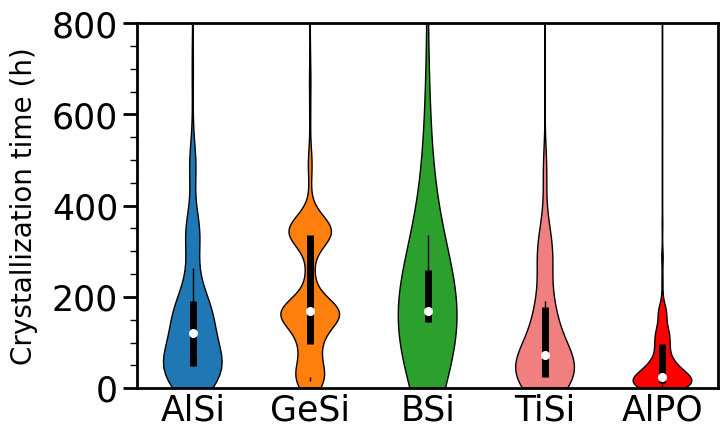

In [35]:
# Crystallization time distributions across different chemistries
data     = [cryst_time_SiAl, cryst_time_SiGe, cryst_time_SiB, cryst_time_SiT, cryst_time_AlP]
x_labels = ['AlSi', 'GeSi', 'BSi', 'TiSi', 'AlPO']
colors = ['tab:blue', 'tab:orange', 'tab:green', 'lightcoral', 'red', 'darkred' ,'tab:purple']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7.5, 5), dpi = 100)


parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=1000,
)

for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)
plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 
plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(0,800)
plt.ylabel('Crystallization time (h)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

# Set the x-tick interval
plt.yticks(np.arange(0, 1000, 200))

plt.show()

# Crystallization time w.r.t. pore type

In [36]:
cryst_time_s_pore = list(cryst_time[cryst_time.index.isin(df[df['pore_type'] == 'Small'].index)])
cryst_time_m_pore = list(cryst_time[cryst_time.index.isin(df[df['pore_type'] == 'Medium'].index)])
cryst_time_l_pore = list(cryst_time[cryst_time.index.isin(df[df['pore_type'] == 'Large'].index)])
cryst_time_xl_pore = list(cryst_time[cryst_time.index.isin(df[df['pore_type'] == 'Extra-large'].index)])

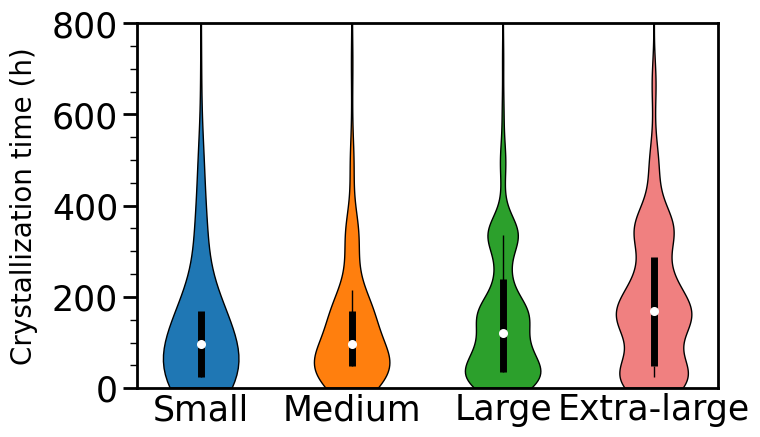

In [37]:
# Crystallization time distributions across different pore sizes
data     = [cryst_time_s_pore, cryst_time_m_pore, cryst_time_l_pore, cryst_time_xl_pore]
x_labels = ['Small', 'Medium', 'Large', 'Extra-large']
colors = ['tab:blue', 'tab:orange', 'tab:green', 'lightcoral', 'red', 'darkred' ,'tab:purple']

fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(7.5, 5), dpi = 100)


parts = ax.violinplot(
        data, showmeans=False, showmedians=False,
        showextrema=False,
        points=1000,
)

for pc, c in zip(parts['bodies'], colors):
    pc.set_facecolor(c)
    pc.set_edgecolor('black')
    pc.set_alpha(1)

quartile1_list, medians_list, quartile3_list= [], [], []
for d in data:
    quartile1, medians, quartile3 = np.percentile(d, [25, 50, 75])
    quartile1_list.append(quartile1)
    medians_list.append(medians)
    quartile3_list.append(quartile3)

whiskers = np.array([
    adjacent_values(sorted_array, q1, q3)
    for sorted_array, q1, q3 in zip(data, quartile1_list, quartile3_list)])
whiskers_min, whiskers_max = whiskers[:, 0], whiskers[:, 1]

inds = np.arange(1, len(data) + 1)
ax.scatter(inds, medians_list, marker='o', color='white', s=30, zorder=3)
ax.vlines(inds, quartile1_list, quartile3_list, color='k', linestyle='-', lw=5)
ax.vlines(inds, whiskers_min, whiskers_max, color='k', linestyle='-', lw=1)
plt.xticks(np.arange(1, len(x_labels) + 1), x_labels, fontsize = 25)
plt.yticks(fontsize=25) 
plt.subplots_adjust(bottom=0.15, wspace=0.05)
plt.ylim(0,800)
plt.ylabel('Crystallization time (h)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(2)    # Top axis line
ax.spines['right'].set_linewidth(2)  # Right axis line
ax.spines['bottom'].set_linewidth(2) # Bottom axis line
ax.spines['left'].set_linewidth(2)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=2)
plt.tick_params(axis='y', which='minor', length=5, width=1)
plt.tick_params(axis='x', which='major', length=0, width=0)
plt.tick_params(axis='x', which='minor', length=0, width=0)

# Set the x-tick interval
plt.yticks(np.arange(0, 1000, 200))

plt.show()

# Crystallization temp vs. time

In [38]:
cryst_temp_time = df[['cryst_temp', 'cryst_time']]
cryst_temp_time = cryst_temp_time[
                                    (~cryst_temp_time['cryst_temp'].isna()) \
                                 &  (~cryst_temp_time['cryst_time'].isna())
                                 ]

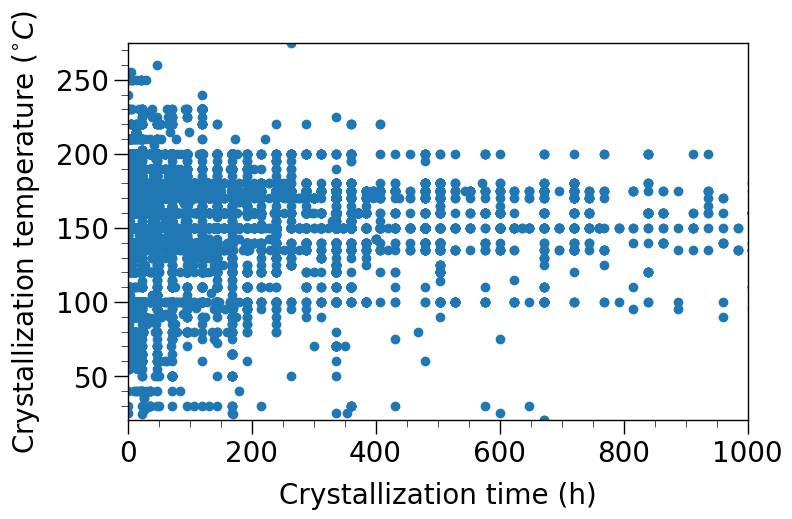

In [39]:
# Aggregated
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 100)

hb = plt.scatter(x=cryst_temp_time['cryst_time'] , y=cryst_temp_time['cryst_temp'])

plt.yticks(fontsize=20) 
plt.xticks(fontsize=20) 

plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
plt.xlabel('Crystallization time (h)', fontsize=20, labelpad=10)

# Set the line thickness of the axes
ax.spines['top'].set_linewidth(1)    # Top axis line
ax.spines['right'].set_linewidth(1)  # Right axis line
ax.spines['bottom'].set_linewidth(1) # Bottom axis line
ax.spines['left'].set_linewidth(1)   # Left axis line

# Set the length and size of major/minor tick marks on the y-axis
plt.minorticks_on()
plt.tick_params(axis='y', which='major', length=10, width=1)
plt.tick_params(axis='y', which='minor', length=5, width=0.5)
plt.tick_params(axis='x', which='major', length=10, width=1)
plt.tick_params(axis='x', which='minor', length=5, width=0.5)

plt.xlim(0,1000)
plt.ylim(20,275)

plt.show()

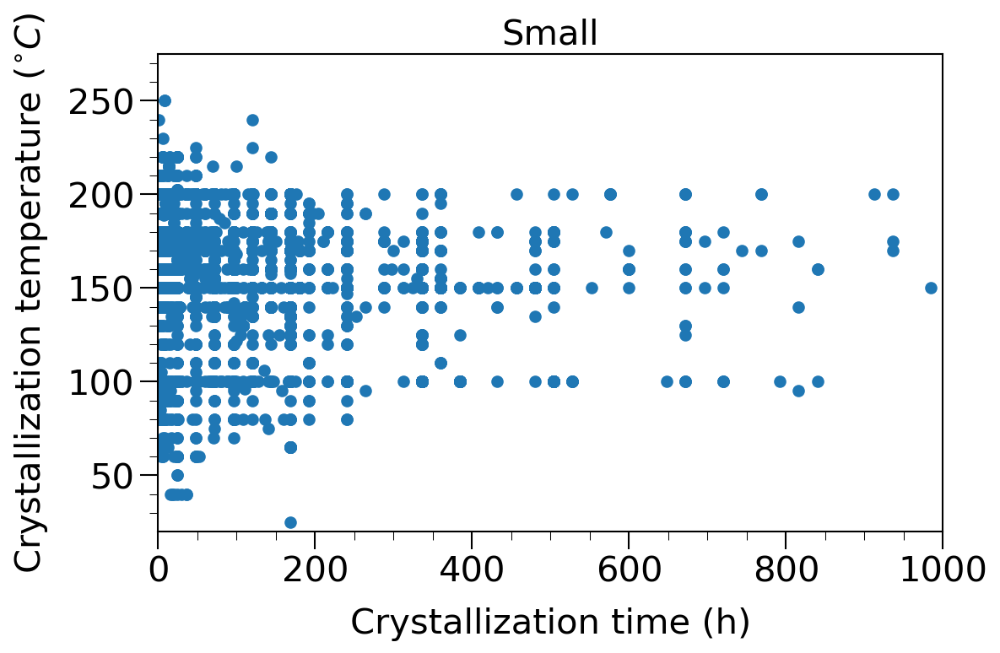

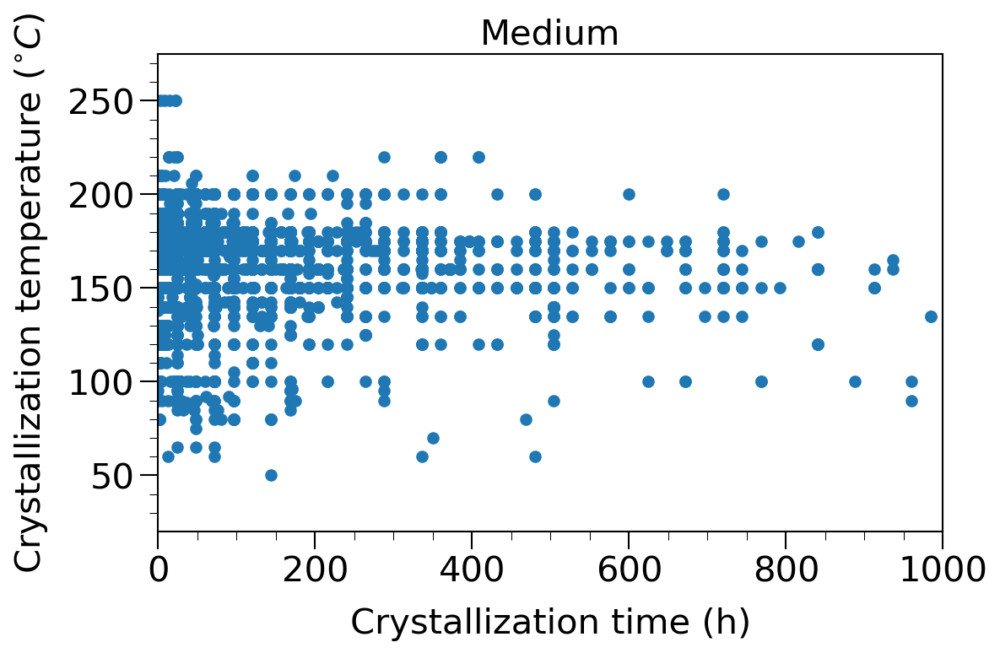

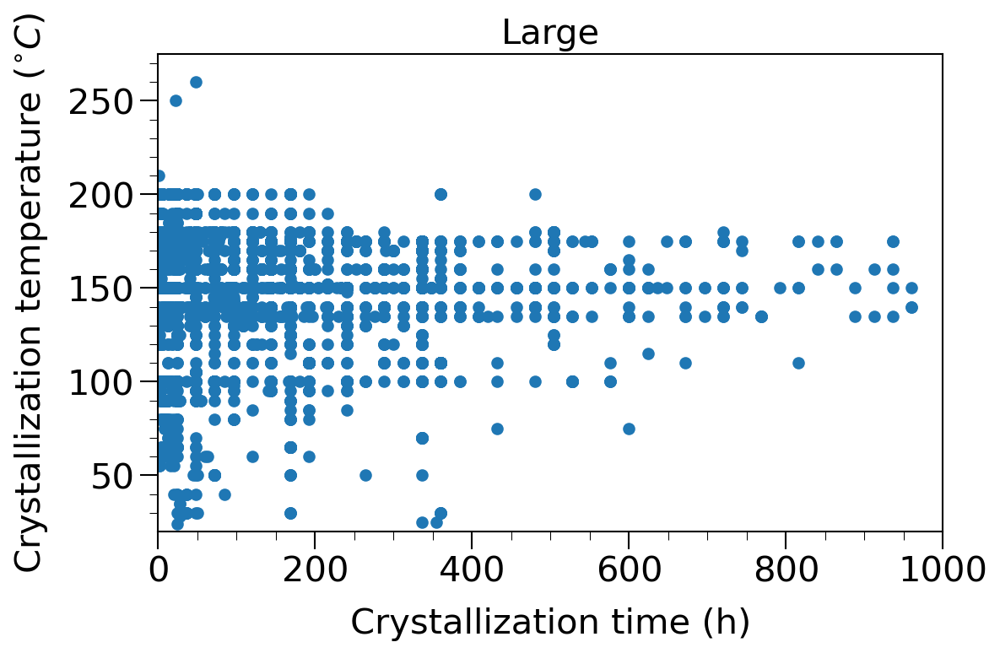

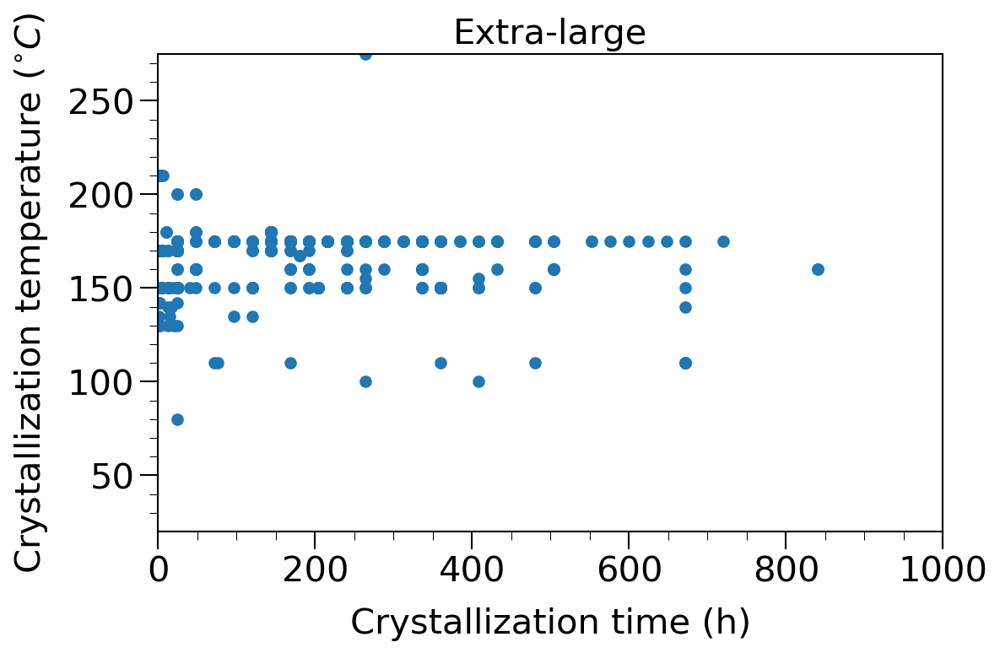

In [40]:
# Cryst_temp vs. cryst_time for each pore class

pore_classes = ['Small', 'Medium', 'Large', 'Extra-large']
pore_dfs     = [df_s_pore, df_m_pore, df_l_pore, df_xl_pore]
colors       = [s_pore_c, m_pore_c, s_pore_c, m_pore_c]

for pore_class, pore_df in zip(pore_classes, pore_dfs):
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 150)
    
    data = cryst_temp_time.loc[cryst_temp_time.index.isin(pore_df.index)] # Select synthesis of only a certain pore type
    
    if pore_class=='Small':
        cmap = 'Oranges'
    elif pore_class=='Medium':
        cmap = 'Blues'
    elif pore_class=='Large':
        cmap = 'Greens'
    elif pore_class=='Extra-large':
        cmap = 'Purples'
    
    hb = plt.scatter(x=data['cryst_time'] , y=data['cryst_temp'])

    plt.yticks(fontsize=20) 
    plt.xticks(fontsize=20) 

    plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
    plt.xlabel('Crystallization time (h)', fontsize=20, labelpad=10)
    plt.title('{}'.format(pore_class), fontsize = 20)

    # Set the line thickness of the axes
    ax.spines['top'].set_linewidth(1)    # Top axis line
    ax.spines['right'].set_linewidth(1)  # Right axis line
    ax.spines['bottom'].set_linewidth(1) # Bottom axis line
    ax.spines['left'].set_linewidth(1)   # Left axis line

    # Set the length and size of major/minor tick marks on the y-axis
    plt.minorticks_on()
    plt.tick_params(axis='y', which='major', length=10, width=1)
    plt.tick_params(axis='y', which='minor', length=5, width=0.5)
    plt.tick_params(axis='x', which='major', length=10, width=1)
    plt.tick_params(axis='x', which='minor', length=5, width=0.5)

    plt.xlim(0,1000)
    plt.ylim(20,275)

    plt.show()

# Crystallization temp vs. time for different zeotypes

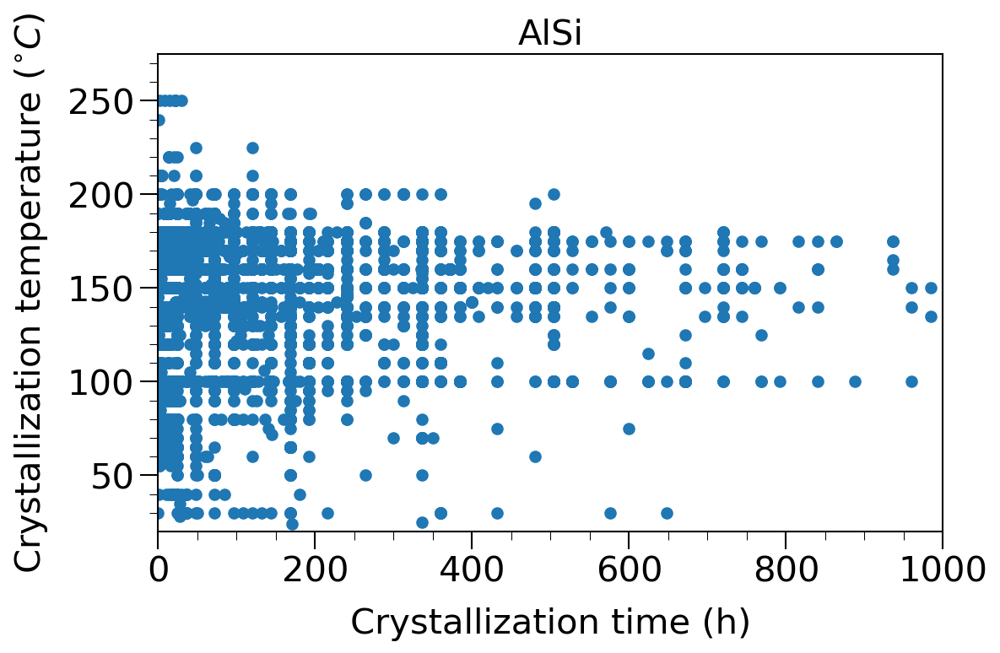

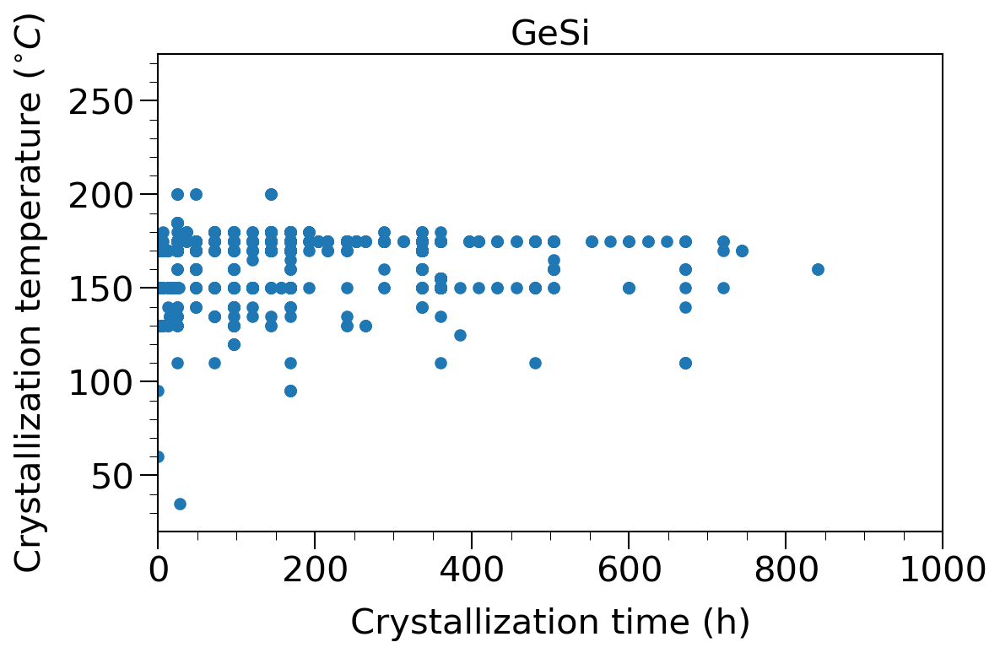

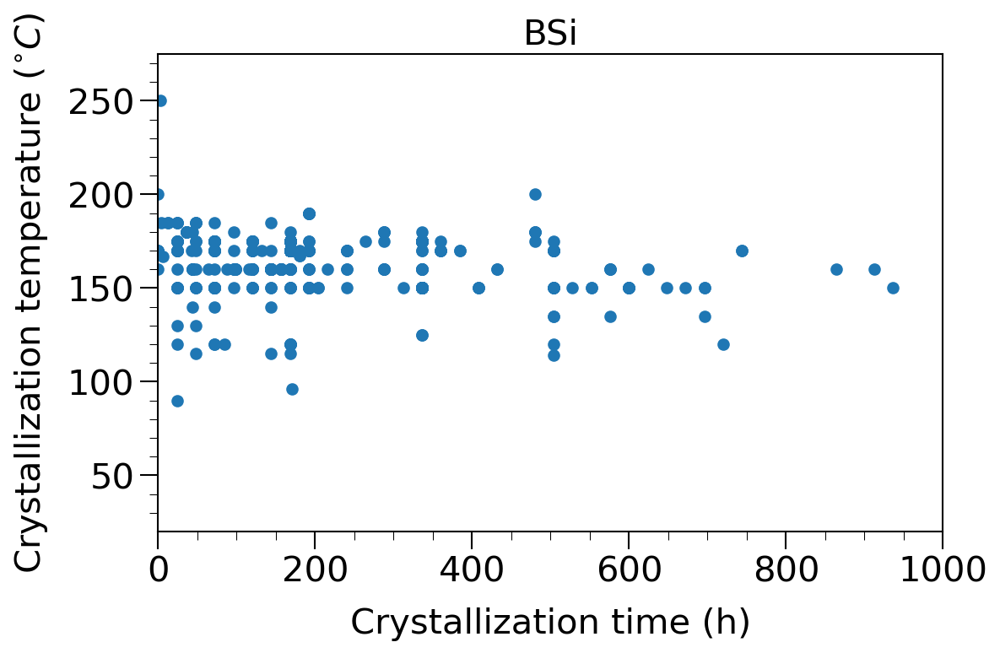

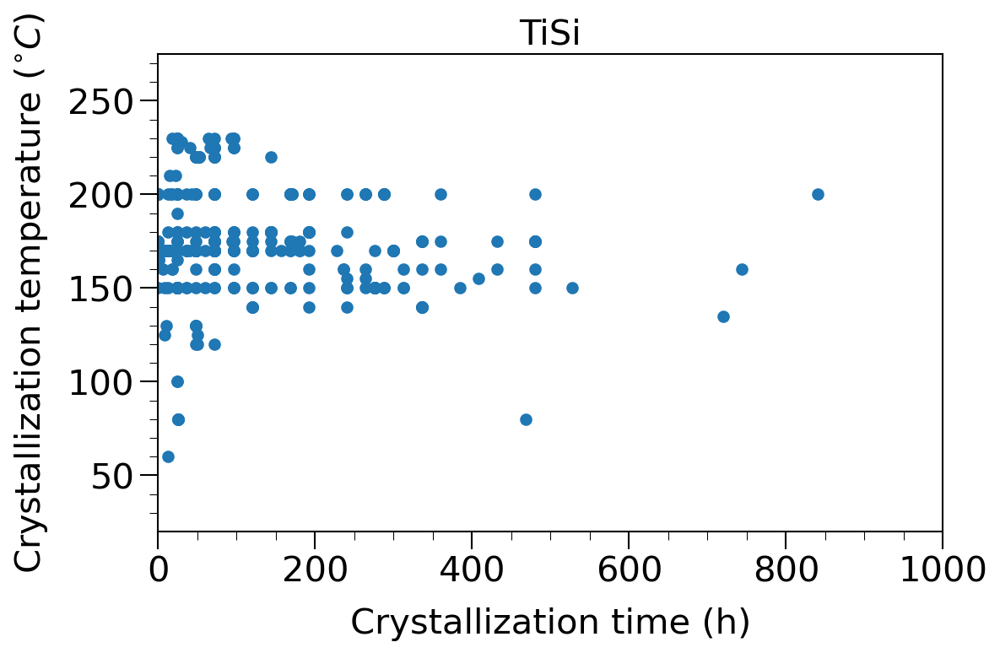

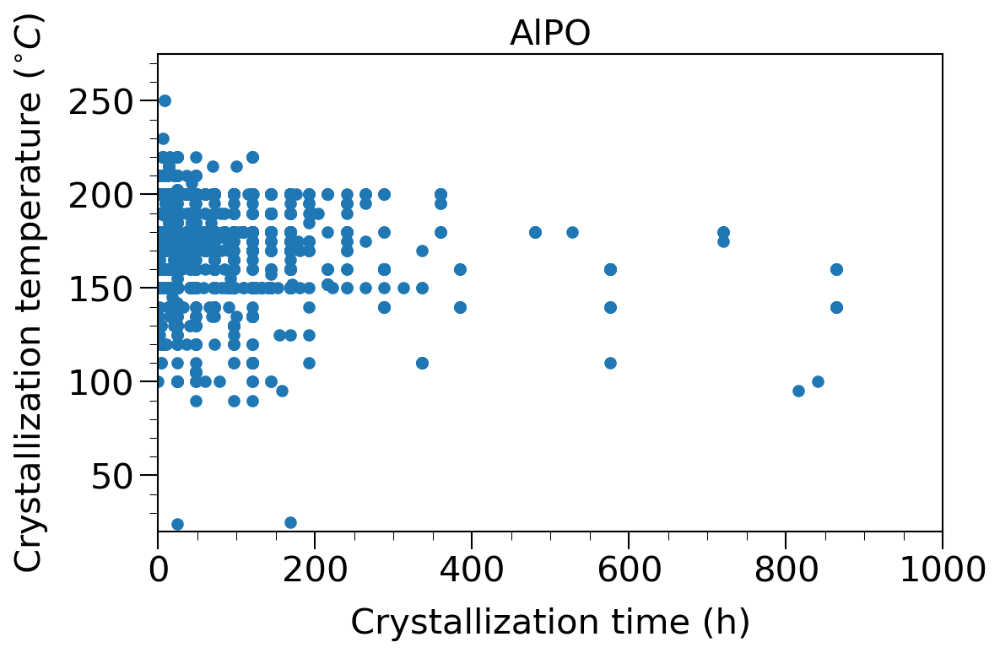

In [41]:
# Cryst_temp vs. cryst_time for each pore class

zeotype_classes = ['AlSi', 'GeSi', 'BSi', 'TiSi', 'AlPO']
zeotype_dfs  = [SiAl, SiGe, SiB, SiT, AlP]

for zeotype_class, zeotype_df in zip(zeotype_classes, zeotype_dfs):
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(8, 5), dpi = 150)
    
    data = cryst_temp_time.loc[cryst_temp_time.index.isin(zeotype_df.index)] # Select synthesis of only a certain pore type
    
    if zeotype_class=='AlSi':
        cmap = 'Blues'
    elif zeotype_class=='GeSi':
        cmap = 'Oranges'
    elif zeotype_class=='BSi':
        cmap = 'Greens'
    elif zeotype_class=='TiSi':
        cmap = 'Purples'
    elif zeotype_class=='AlPO':
        cmap = 'Reds'
    
    hb = plt.scatter(x=data['cryst_time'], y=data['cryst_temp'])

    plt.yticks(fontsize=20) 
    plt.xticks(fontsize=20) 

    plt.ylabel('Crystallization temperature ($^{\circ}C$)', fontsize=20, labelpad=10)
    plt.xlabel('Crystallization time (h)', fontsize=20, labelpad=10)
    plt.title('{}'.format(zeotype_class), fontsize = 20)

    # Set the line thickness of the axes
    ax.spines['top'].set_linewidth(1)    # Top axis line
    ax.spines['right'].set_linewidth(1)  # Right axis line
    ax.spines['bottom'].set_linewidth(1) # Bottom axis line
    ax.spines['left'].set_linewidth(1)   # Left axis line

    # Set the length and size of major/minor tick marks on the y-axis
    plt.minorticks_on()
    plt.tick_params(axis='y', which='major', length=10, width=1)
    plt.tick_params(axis='y', which='minor', length=5, width=0.5)
    plt.tick_params(axis='x', which='major', length=10, width=1)
    plt.tick_params(axis='x', which='minor', length=5, width=0.5)

    plt.xlim(0,1000)
    plt.ylim(20,275)

    plt.show()

# t-SNE plot of synthesis space

In [42]:
df_without_na = df[~df['doi'].isna()]
df_without_na = df_without_na[~df_without_na['Code1'].isna()] # remove failed synthesis
df_tsne = df_without_na[tsne_cols]

In [43]:
# Imputation for NaN in cryst_time and cryst_temp
columns = list(df_tsne.columns) # Save columns
imp = IterativeImputer(min_value = 0., sample_posterior = True, skip_complete = True, random_state=0) # Sample posterior to get a distribution, skip_complete to speed up, min value is 0. since time and temp are +ve
imp.fit(df_tsne)
df_tsne = pd.DataFrame(imp.transform(df_tsne), columns = df_tsne.columns)

In [44]:
# Dimension reduction plot for most frequent zeolites
scaler = StandardScaler()
scaler.fit(np.array(df_tsne))
df_tsne_scaled = scaler.transform(np.array(df_tsne))
embed = TSNE(n_components=2, perplexity=50., init='pca', random_state = 0).fit_transform(df_tsne_scaled)

df_without_na['tsne_0'], df_without_na['tsne_1'] = embed[:,0], embed[:,1]

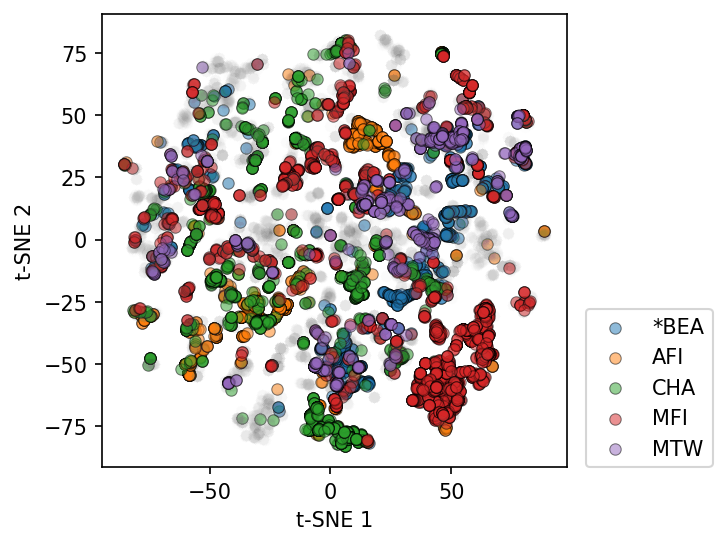

In [45]:
n_zeos = 5 # number of zeos to color
plt.figure(figsize = (4,4), dpi = 150)
for zeo, data in df_without_na.groupby('Code1'):
    if zeo in zeos_value_counts[:n_zeos]: # top n zeolites
        plt.scatter(data['tsne_0'], data['tsne_1'], s = 30, alpha = 0.5, label = zeo,
                            edgecolor = 'black', linewidth = 0.5)
    else:
        plt.scatter(data['tsne_0'], data['tsne_1'], s = 30, alpha = 0.01, color = 'grey',
                            edgecolor = 'grey', linewidth = 0.01)
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(loc=(1.04, 0))
plt.show()

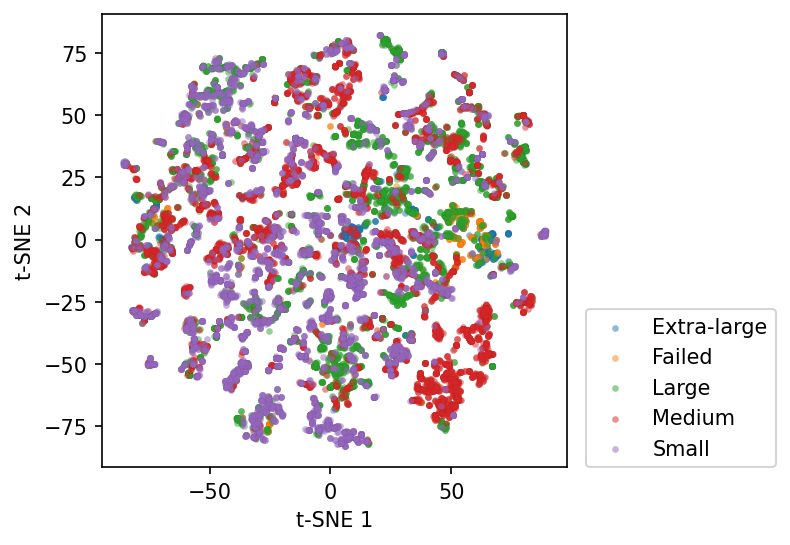

In [46]:
# Pore type
plt.figure(figsize = (4,4), dpi = 150)
for zeo, data in df_without_na.groupby('pore_type'):
    plt.scatter(data['tsne_0'], data['tsne_1'], s = 10, alpha = 0.5, label = zeo,
                            edgecolor = 'black', linewidth = 0.01)
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(loc=(1.04, 0))
plt.show()

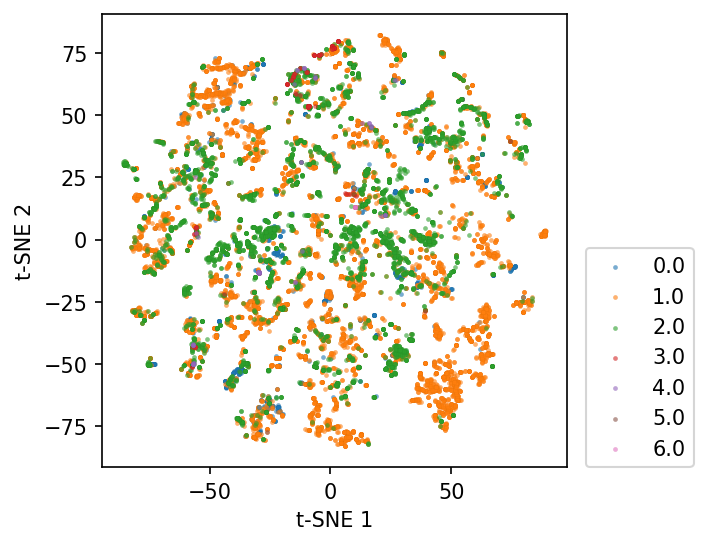

In [47]:
# Num of channels
plt.figure(figsize = (4,4), dpi = 150)
for zeo, data in df_without_na.groupby('chan_num_channels'):
    plt.scatter(data['tsne_0'], data['tsne_1'], s = 5, alpha = 0.6, label = zeo,
                            edgecolor = 'black', linewidth = 0.01)
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.legend(loc=(1.04, 0))
plt.show()

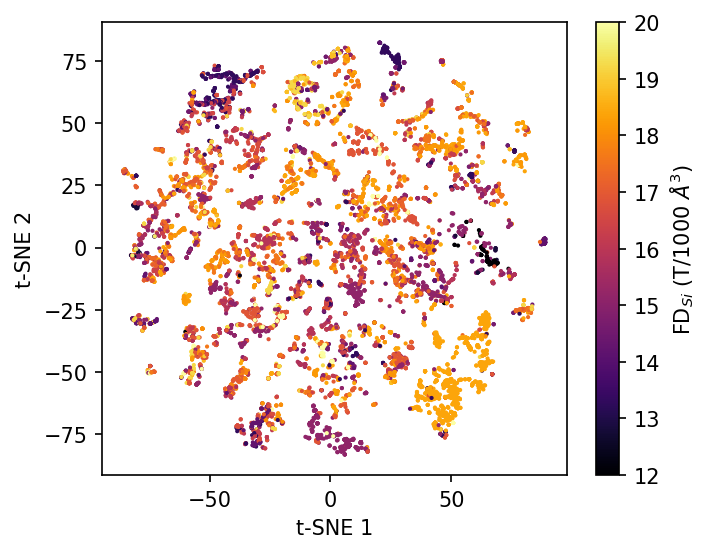

In [48]:
# Framework density
plt.figure(figsize = (5,4), dpi = 150)
plt.scatter(df_without_na['tsne_0'], df_without_na['tsne_1'], s = 1, alpha = 1, label = zeo, 
            c = df_without_na['framework_density'], cmap = 'inferno')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.colorbar(label = 'FD$_{Si}$ (T/1000 $\AA^{3}$)')
plt.clim(12,20)
plt.show()

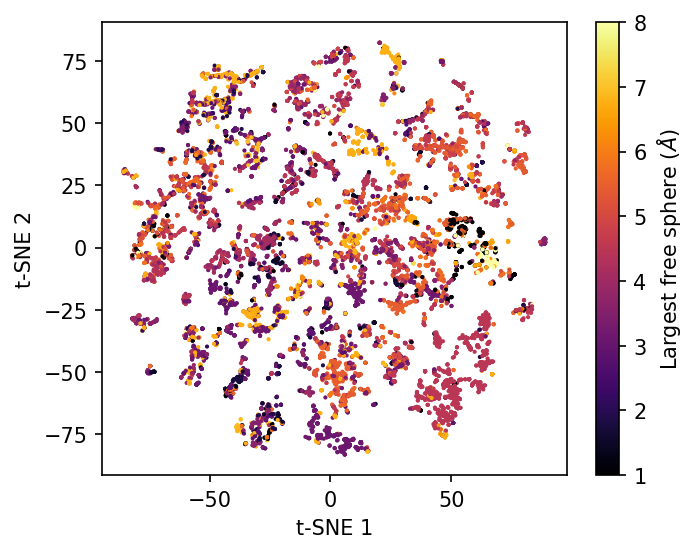

In [49]:
# Largest free sphere
plt.figure(figsize = (5,4), dpi = 150)
plt.scatter(df_without_na['tsne_0'], df_without_na['tsne_1'], s = 1, alpha = 1, label = zeo, 
            c = df_without_na['largest_free_sphere'], cmap = 'inferno')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
cb = plt.colorbar(label = "Largest free sphere ($\AA$)")
plt.clim(1,8) 
plt.show()

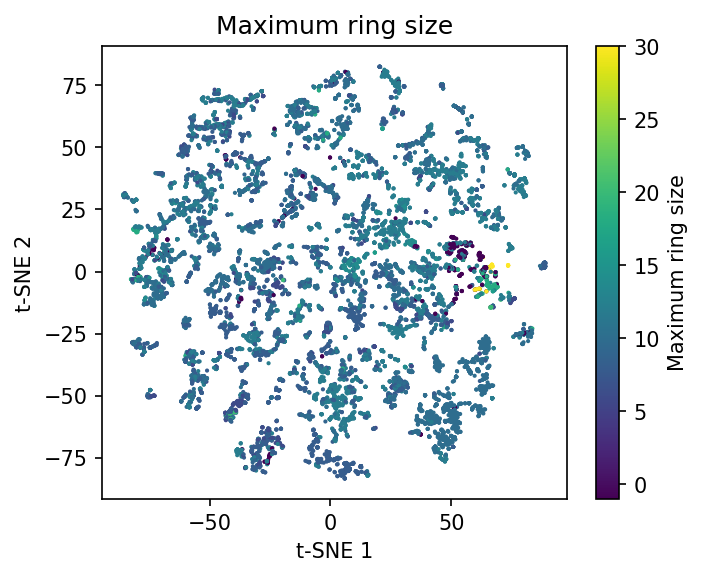

In [50]:
# Max ring size
plt.figure(figsize = (5,4), dpi = 150)

plt.scatter(df_without_na['tsne_0'], df_without_na['tsne_1'], s = 1, alpha = 1, label = zeo, 
            c = df_without_na['ring_size_0'], cmap = 'viridis')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
cb = plt.colorbar(label = "Maximum ring size")
plt.title('Maximum ring size')
# plt.clim(5,30) 
plt.show()

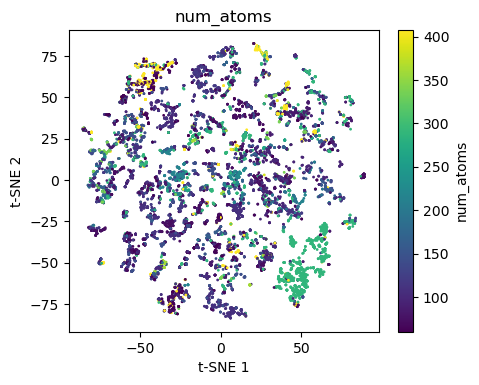

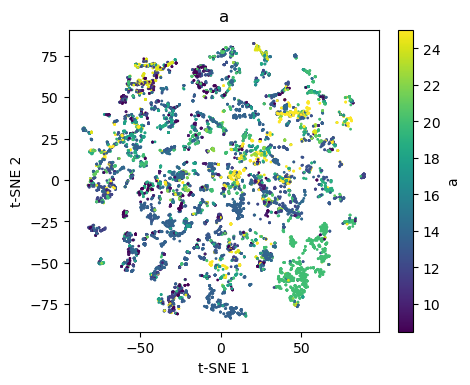

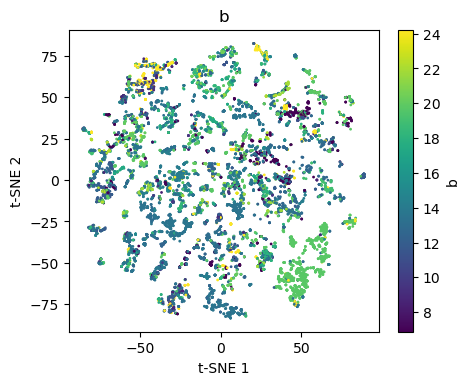

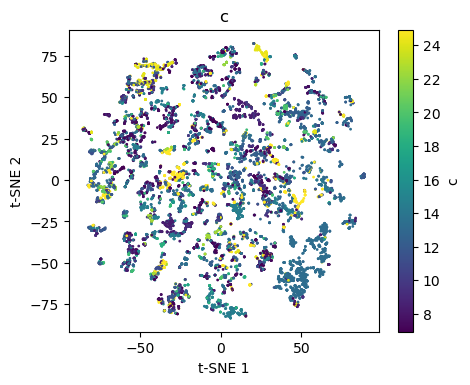

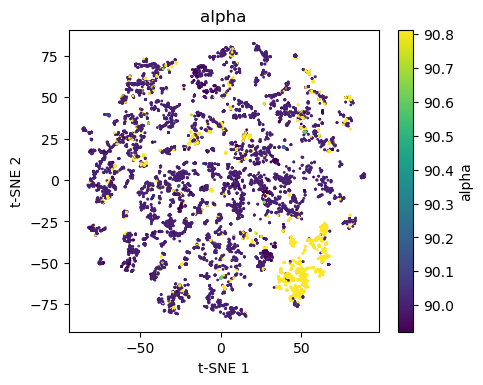

...

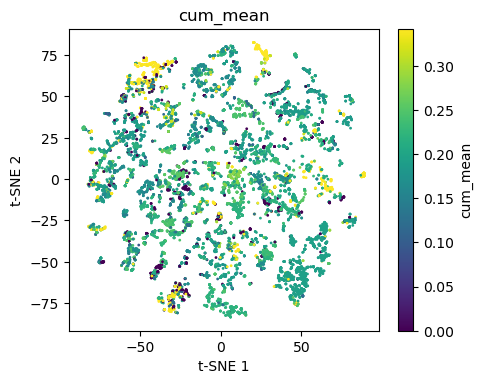

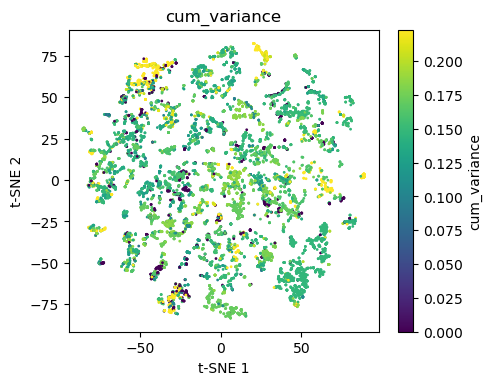

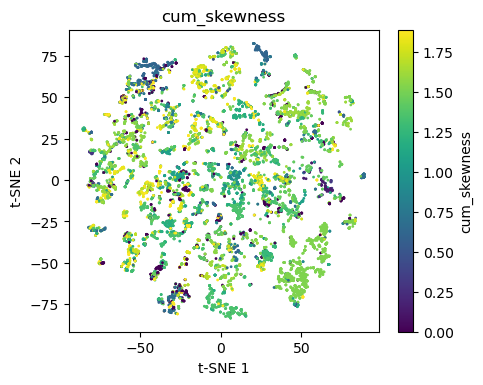

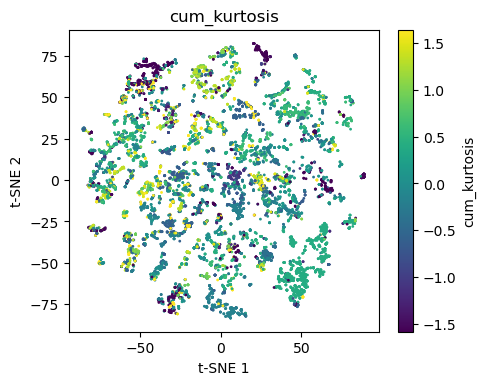

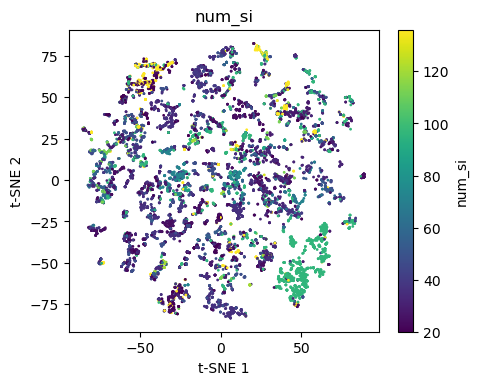

In [51]:
# Continuous zeolite descriptors
for col in zeo_cols_cont:
    plt.figure(figsize = (5,4), dpi = 100)
    
    plt.scatter(df_without_na['tsne_0'], df_without_na['tsne_1'], s = 1, alpha = 1, label = zeo, 
                c = df_without_na[col], cmap = 'viridis')
    plt.xlabel('t-SNE 1')
    plt.ylabel('t-SNE 2')
    plt.title(col)
    cb = plt.colorbar(label = col)
    if df_without_na[col].isna().sum() != len(df_without_na[col].isna()): # if not all values are NaN,
        plt.clim(np.percentile(df_without_na[col].dropna(), [5,95]))
    plt.show()

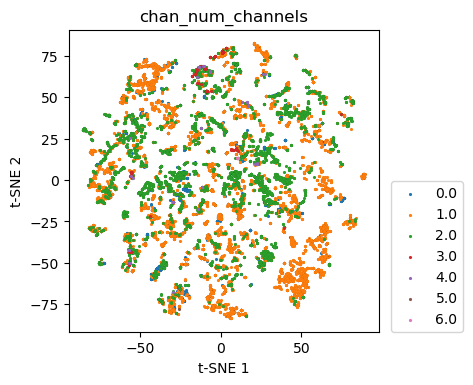

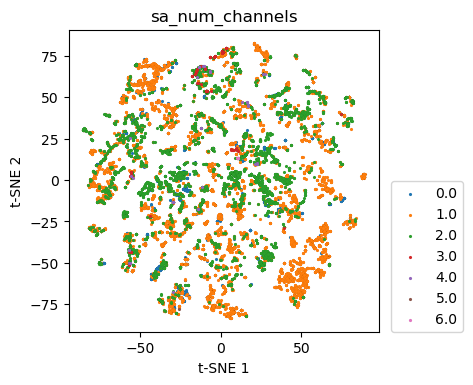

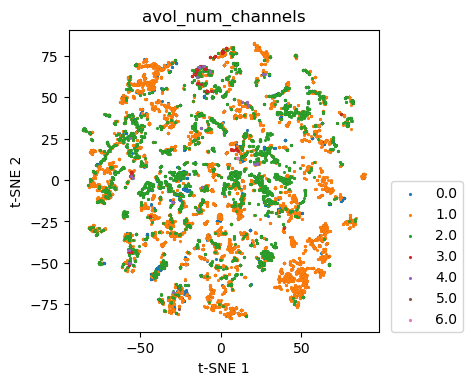

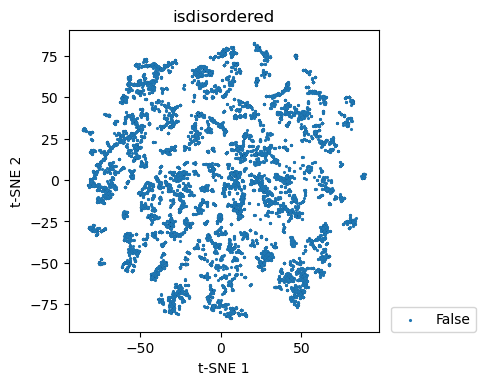

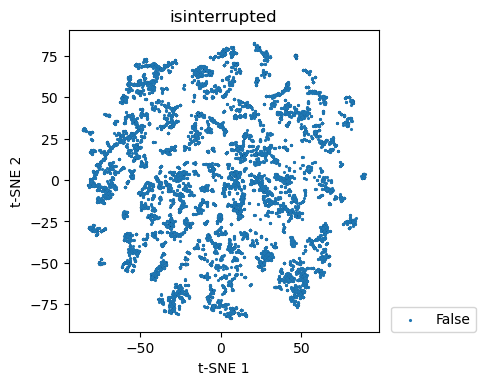

In [52]:
# Discrete zeolite descriptors
for col in zeo_cols_disc:
    plt.figure(figsize = (4,4), dpi = 100)
    for label, data in df_without_na.groupby(col):
        plt.scatter(data['tsne_0'], data['tsne_1'], s = 5, alpha = 1, label = label,
                                edgecolor = 'black', linewidth = 0.01)
    plt.title(col)
    plt.xlabel('t-SNE 1')
    plt.ylabel('t-SNE 2')
    plt.legend(loc=(1.04, 0))
    plt.show()

In [53]:
# Find unique set of cbus present in dataset
cbus_unique = []
for cbu_combination in df_without_na['cbu'].value_counts().index:
    for cbu in cbu_combination:
        if cbu not in cbus_unique:
            cbus_unique.append(cbu)

# Get one-hot encoding of cbus
cbu_oh = np.zeros([len(df_without_na), len(cbus_unique)]) # initialize one-hot encoding with zeros
cbu_oh = pd.DataFrame(cbu_oh, columns = cbus_unique, index = df_without_na.index)

for idx in df_without_na.index:
    cbus = df_without_na.loc[idx]['cbu']
#     print(cbus)
    if (cbus == None) or (len(cbus) == 0): # either None or empty list
        pass
    elif (len(cbus) > 0) and (type(cbus) == list): # if non-empty list of cbus exists 
#         print('list exists')
        for cbu in cbus: # modify one-hot encoding of cbus
            cbu_oh.loc[idx, cbu] = 1.0
#     print()

# Append one-hot encoding of CBUs to df_without_na
df_without_na = pd.concat([df_without_na, cbu_oh], axis = 1)

In [54]:
# Check distribution of synthesis with zeolite containing a specific CBU
target_cbu = 'sod'
df_without_na[df_without_na[target_cbu] == 1.]['Code1'].value_counts()

LTA    556
FAU    546
SOD    210
EMT    143
LTN      3
Name: Code1, dtype: int64

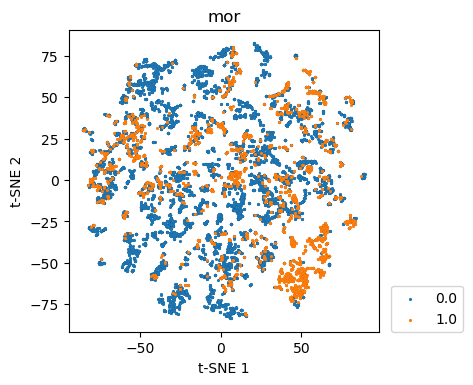

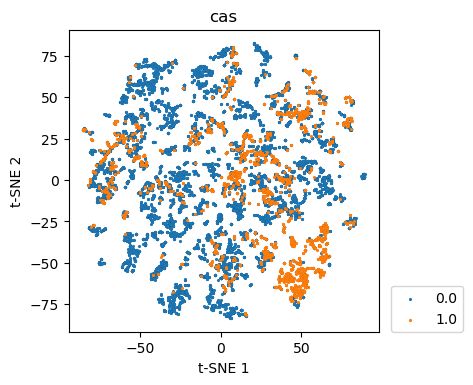

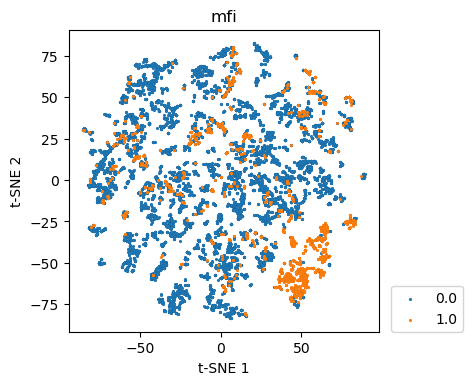

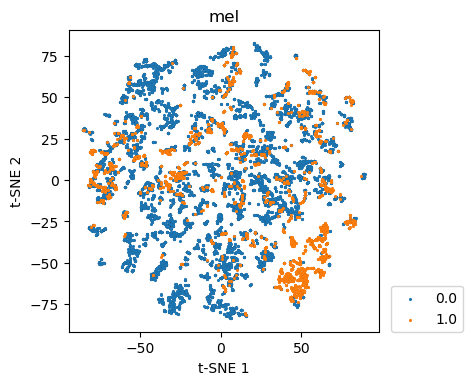

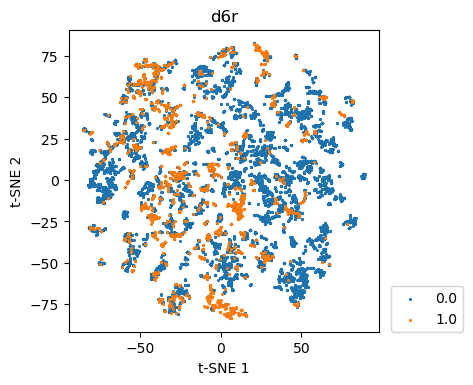

...

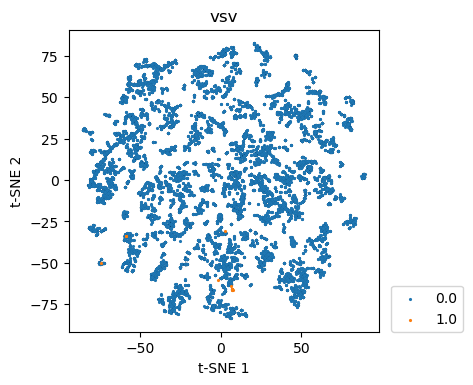

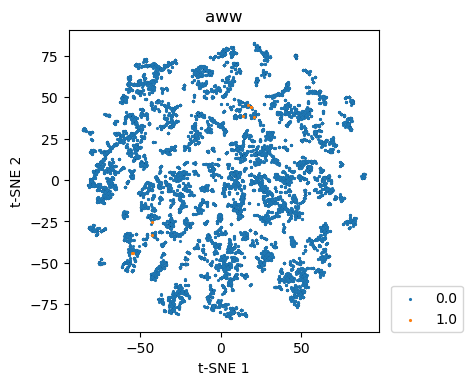

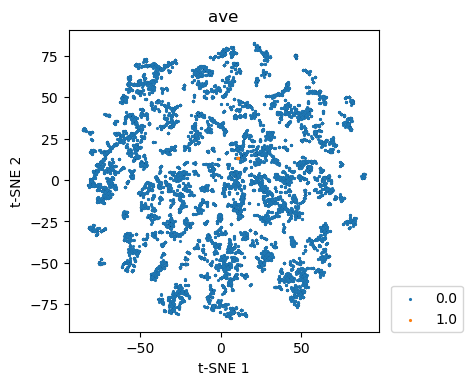

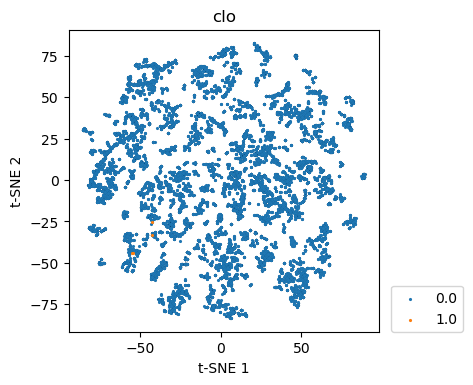

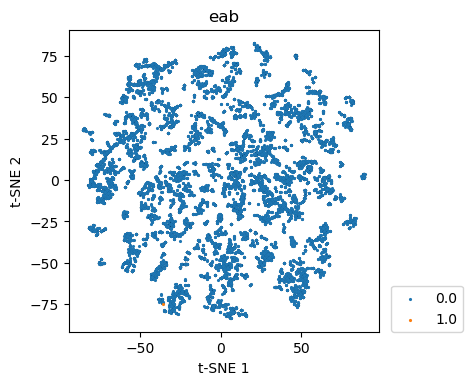

In [55]:
# t-SNE plots of CBUs
for cbu in cbus_unique:
    plt.figure(figsize = (4,4), dpi = 100)
    for label, data in df_without_na.groupby(cbu):
        plt.scatter(data['tsne_0'], data['tsne_1'], s = 5, alpha = 1, label = label,
                                edgecolor = 'black', linewidth = 0.01
                       )
    plt.title(cbu)
    plt.xlabel('t-SNE 1')
    plt.ylabel('t-SNE 2')
    plt.legend(loc=(1.04, 0))
    plt.show()

# OSDA hierarchical clustering 

In [56]:
n_osdas = 50
most_freq_osdas = list(df['osda1 smiles'].value_counts().iloc[:n_osdas].index)

In [57]:
# Select subset of OSDA features
df_osda = df_osda[[x for x in df_osda.columns if \
                                                   ('morgan' in x) \
                                                 | ('osda smiles' in x) \
                                        ]]

# Keep only 100 most frequent OSDAs
df_osda = df_osda[df_osda['osda smiles'].isin(most_freq_osdas)]

df_osda_T = df_osda.T
df_osda_T = df_osda_T.drop(index = 'osda smiles')
df_osda_T.columns = df_osda['osda smiles']

In [58]:
df_osda_T_scaled = (df_osda_T-df_osda_T.min())/(df_osda_T.max()-df_osda_T.min()).astype(float)
df_osda_T_scaled = df_osda_T_scaled.astype(float)

In [59]:
osda_rmsd = pd.DataFrame(rmsd_matrix(df_osda_T_scaled.T.to_numpy(), df_osda_T_scaled.T.to_numpy()),
                        index = df_osda_T_scaled.columns, columns = df_osda_T_scaled.columns)

/home/synthesisproject/anaconda3/envs/zeo_classification/lib/python3.7/site-packages/seaborn/matrix.py:625: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  metric=self.metric)


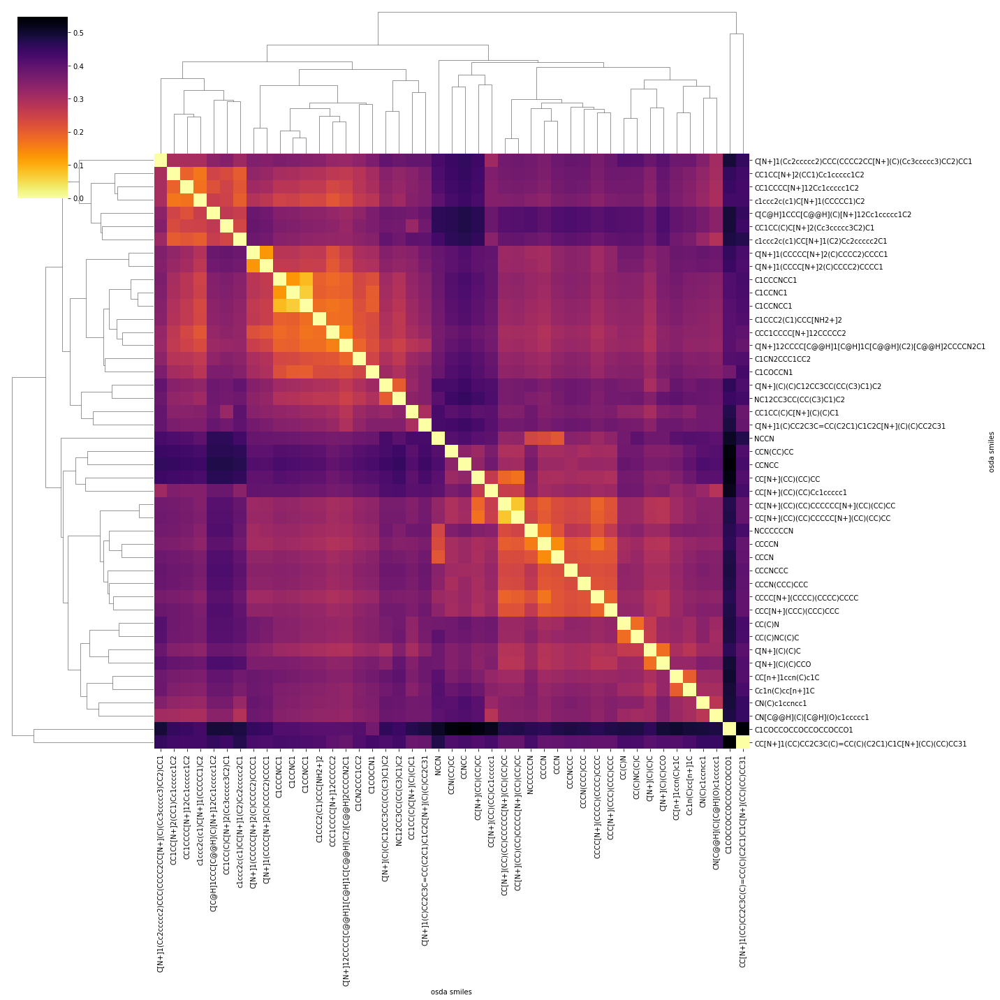

In [60]:
sns.clustermap(osda_rmsd, cmap = "inferno_r", figsize=(20, 20))

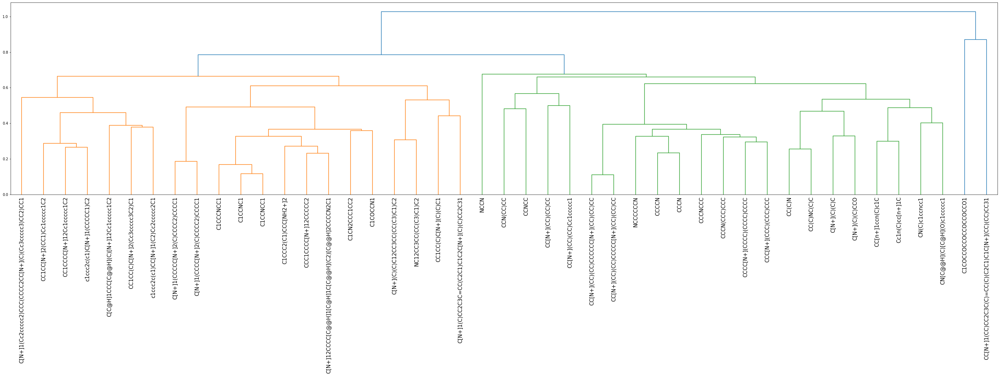

In [61]:
row_linkage = hierarchy.linkage(
    distance.pdist(osda_rmsd.to_numpy()), method='average')

fig = plt.figure(figsize=(50, 10))
ax = fig.add_subplot(1, 1, 1)

dendro = hierarchy.dendrogram(row_linkage, labels = osda_rmsd.columns.tolist(), ax = ax)
ax.tick_params(axis='x', which='major', labelsize=15)

plt.show()

(46, 45) (46, 45) (45, 45)


/home/synthesisproject/anaconda3/envs/zeo_classification/lib/python3.7/site-packages/ipykernel_launcher.py:159: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
/home/synthesisproject/anaconda3/envs/zeo_classification/lib/python3.7/site-packages/ipykernel_launcher.py:174: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
/home/synthesisproject/anaconda3/envs/zeo_classification/lib/python3.7/site-packages/ipykernel_launcher.py:174: MatplotlibDeprecationWarning: Passing 

(0.3207208224565667, 0.03171216897465872)
SpearmanrResult(correlation=0.524564270509943, pvalue=0.00021647502778652543)


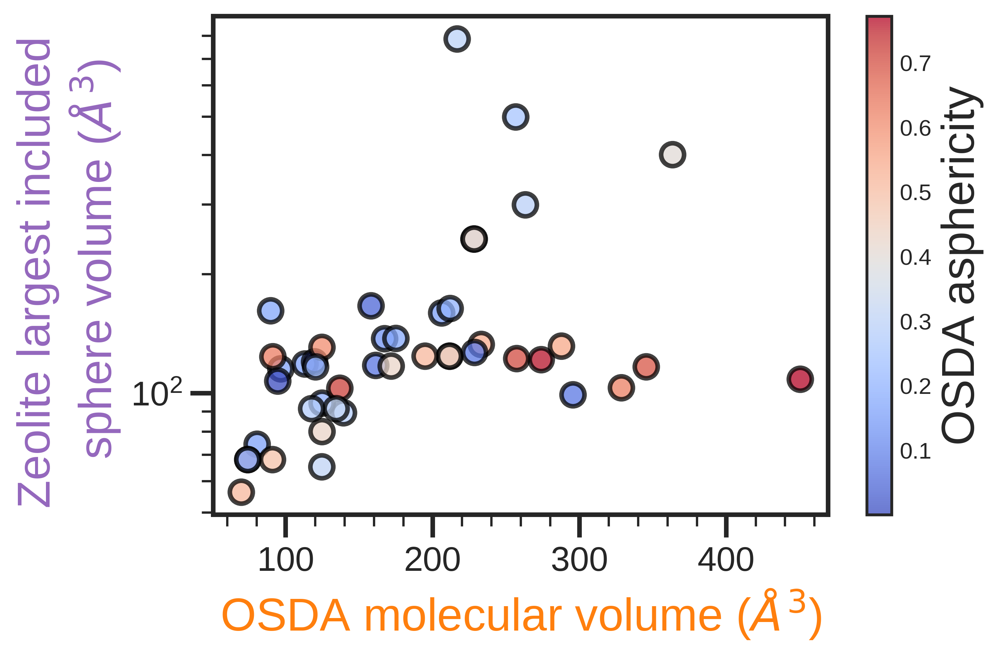

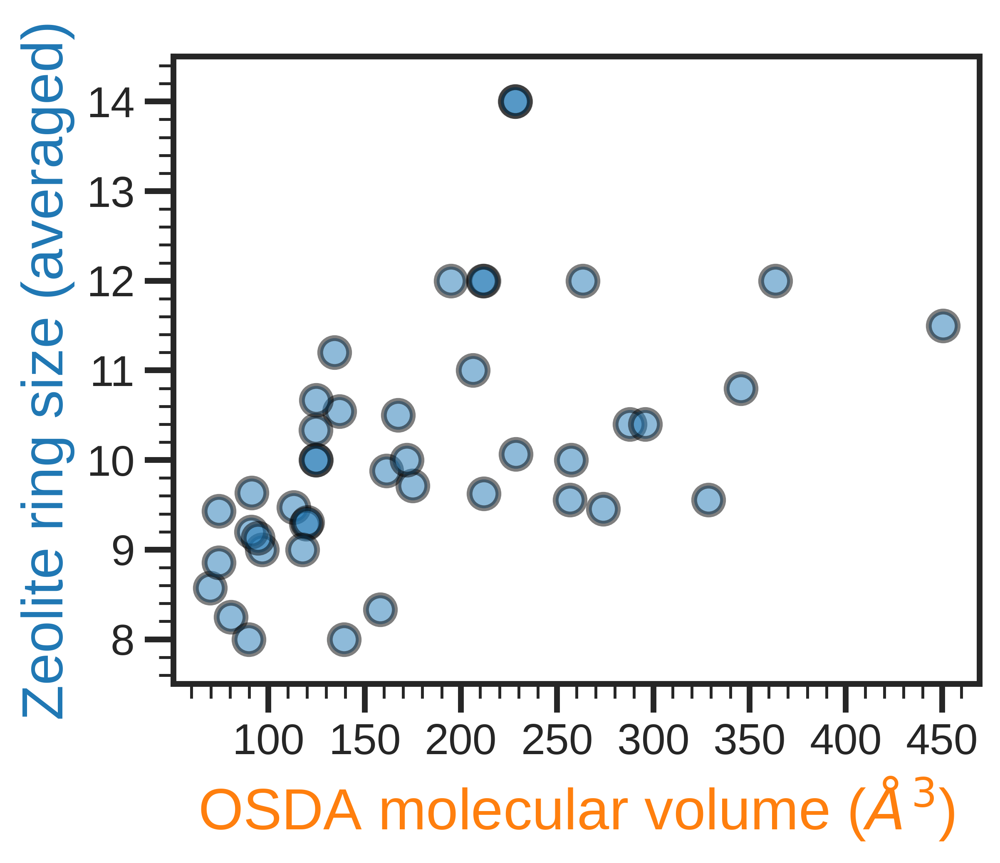

In [62]:
def plot_dendrogram(icoord,dcoord,figsize, osda_labels = [], polar=False):
    if polar:
        radius = 20 # radius of circle
        dcoord = -dcoord*radius
#         dcoord = -np.log(dcoord+1)*radius
        gap = 0.1
        imax = icoord.max()
        imin = icoord.min()
        icoord = ((icoord - imin)/(imax - imin)*(1-gap) + gap/2)*2*np.pi
        
    with plt.style.context("seaborn-white"):
        fig = plt.figure(figsize=figsize, dpi=500)
        ax = fig.add_subplot(111, polar=polar)
        
        for xs, ys in zip(icoord, dcoord):
            start, end = xs[0], xs[2]
            
            # Default colors
            color = 'black'
            linewidth = 3
            
#             # Grp A
#             if (start > 0) and (end < 1.2) and (ys[1] > -12):
#                 color     = 'tab:red'
#                 linewidth = 7
                
#             # Grp B
#             if (start > 1.2) and (end < 2.4) and (ys[1] > -12):
#                 color     = 'tab:green'
#                 linewidth = 7
                
#             # Grp C
#             if (start > 2.4) and (end < 3.0) and (ys[1] > -12):
#                 color     = 'tab:blue'
#                 linewidth = 7
            
#             # Grp D
#             if (start > 3.0) and (end < 4.8) and (ys[1] > -12):
#                 color     = 'tab:purple'
#                 linewidth = 7
            
#             # Grp E
#             if (start > 4.8) and (end < 6.0) and (ys[1] > -12):
#                 color     = 'tab:orange'
#                 linewidth = 7
            
            if polar:
                xs = smoothsegment(xs)
                ys = smoothsegment(ys)
                
            
            ax.plot(xs,ys, color=color, 
                        linewidth=linewidth
                       )
        if polar:
            ax.spines['polar'].set_visible(False)
            ax.set_xticks([])
            ax.set_yticks([])
#             ax.set_rlabel_position(0)
            Nxticks = len(osda_labels)
            xticks = np.linspace(gap/2, 1-gap/2, Nxticks)
            ax.set_xticks(xticks*np.pi*2)

            ax.set_xticklabels(osda_labels)
            ax.xaxis.grid(False)
            
            
            labels = []
            mol_vols = [] # molecule vol
            mol_asphs = [] # molecule asphericity
            num_zeos = [] # OSDA specificity
            pore_sizes = []
            ring_sizes = []
            angles = []
            for label, angle in zip(ax.get_xticklabels(), xticks*np.pi*2):
                
#                 x,y = angle, 0
#                 lab = ax.text(x,y, label.get_text(), 
#                               transform=label.get_transform(),
#                               ha=label.get_ha(), va=label.get_va(),
#                              fontsize = 20,
#                              )
#                 degrees = np.degrees(angle)
#                 if degrees > 90 and degrees < 270:
#                     degrees = degrees + 180
#                 lab.set_rotation(degrees)
#                 labels.append(lab)
                
                
#                 Draw molecule
                smiles = label.get_text()
                mol = Chem.MolFromSmiles(smiles)
                o = Draw.MolDrawOptions()
                o.bondLineWidth = 5
                mol_img = Draw.MolToImage(mol, options=o, size=(300, 300))
                r = 0.41 # radius of molecule images in fractional
                x_cor, y_cor = -0.01, -0.02 # correction in x y fractions
                img_ax = fig.add_axes([0.5+r*np.cos(angle)+x_cor,0.5+r*np.sin(angle)+y_cor,0.045,0.045], anchor='C', zorder=1)
                img_ax.imshow(mol_img)
                img_ax.axis('off')
    
                # Get properties
                mol_vol = df_osda_all_feats[df_osda_all_feats['osda smiles'] == smiles]['osda_volume_mean_0'].item()
                mol_asph = df_osda_all_feats[df_osda_all_feats['osda smiles'] == smiles]['osda_asphericity_mean_0'].item()
            
                num_zeo = 1/len(df[(df['osda1 smiles'] == smiles) 
#                                  & (df.index.isin(SiAl.index))
                                ]['Code1'].value_counts())
                
                ring_size = df_zeos[df_zeos['Code'].isin(df[(df['osda1 smiles'] == smiles) 
#                                  & (df.index.isin(SiAl.index))
                                ]['Code1'].value_counts().index)]['ring_size_0'].mean()
                
                pore_rads = df_zeos[df_zeos['Code'].isin(df[(df['osda1 smiles'] == smiles) 
#                                  & (df.index.isin(SiAl.index))
                                ]['Code1'].value_counts().index)]['largest_included_sphere']/2. # pore radiuses of all zeolites formed by this OSDA
                pore_size = (4/3*np.pi*(pore_rads**3)).median() # mean of pore volume of all zeolites formed by this OSDA
                
                
                
#                 # annotate with property - OSDA asphericity
#                 x,y = angle, -0.20
#                 lab = ax.text(x,y, round(mol_asph, 3), 
#                               transform=label.get_transform(),
#                               ha=label.get_ha(), va=label.get_va(),
#                              fontsize = 30,
#                              )
#                 degrees = np.degrees(angle)
#                 if degrees > 90 and degrees < 270:
#                     degrees = degrees + 180
#                 lab.set_rotation(degrees)
#                 labels.append(lab)
                
               
                angles.append(angle)
                mol_vols.append(mol_vol)
                mol_asphs.append(mol_asph)
                num_zeos.append(num_zeo)
                pore_sizes.append(pore_size)
                ring_sizes.append(ring_size)
            
            ax.set_xticklabels([])
            ax.set_ylim(top = 2)
            
            
            # Define angles
            n = len(mol_vols)
            step_size = (angles[-1] - angles[0])/(n-1) # step size in radians
            start = angles[0] - step_size/2 # start angle in radians
            end   = angles[-1] + step_size/2# end angle in radians
            a = np.linspace(start, end, n+1) # angles
            
            # Plot property colors - OSDA mol vol
            rad = np.linspace(0, 0.8, n) # radius of coloring, 1st and 2nd correspond to start and end of radius. 0 correspond to outmost radius
            r, th = np.meshgrid(rad, a)
            z = np.array(mol_vols)
            z = np.vstack(n*[z]).T
            print(th.shape, r.shape, z.shape)
            mesh = ax.pcolormesh(th, r, z, cmap ='Oranges')
            ax.plot(a, r, ls='none') 
            cbar_pos = fig.add_axes([0.78,0.43,0.01,0.15])
            cbar = fig.colorbar(mappable = mesh, cax=cbar_pos, ticks=np.arange(0, 500, 100))
            cbar.ax.set_yticklabels(np.arange(0, 500, 100))
            cbar.set_label(label = 'OSDA molecular \n volume ($\AA^3$)', size=30, rotation=270, labelpad=70)
            cbar.ax.tick_params(labelsize=20) 
            
            # Plot property colors - zeolite pore volume
            rad = np.linspace(1.0, 1.8, n) # radius of coloring, 1st and 2nd correspond to start and end of radius. 0 correspond to outmost radius
            r, th = np.meshgrid(rad, a)
            z = np.array(pore_sizes)
            z = np.vstack(n*[z]).T
            mesh = ax.pcolormesh(th, r, z, cmap ='Purples', 
                                 vmin=100, vmax= 200,
                                 norm = LogNorm()
                                )
            ax.plot(a, r, ls='none')
            cbar_pos = fig.add_axes([0.87,0.43,0.01,0.15])
            cbar = fig.colorbar(mappable = mesh, cax=cbar_pos
                                , ticks=[100, 200],
                               )
            cbar.ax.set_yticklabels(['100', '$\geq$200'])
            cbar.ax.minorticks_off()
            cbar.set_label(label = 'Zeolite largest included \n sphere volume ($\AA^3$)', size=30, rotation=270, labelpad=40)
            cbar.ax.tick_params(labelsize=20) 
        
        fig.savefig('figures/osda_dendrogram.jpg', bbox_inches='tight', transparent=True, dpi = 500)

        print(scipy.stats.pearsonr(mol_vols, pore_sizes))
        print(scipy.stats.spearmanr(mol_vols, pore_sizes))
        
        # 1) Zeolite sphere vs. Mol vol
        fig, ax = plt.subplots(dpi=500)
        plt.scatter(mol_vols, pore_sizes, c = mol_asphs, cmap = 'coolwarm', s = 100, alpha = 0.75, edgecolor = 'black', linewidth = 2)
        plt.xlabel('OSDA molecular volume ($\AA^3$)', fontsize = 20, color = 'tab:orange')
        plt.ylabel('Zeolite largest included \n sphere volume ($\AA^3$)', fontsize = 20, color = 'tab:purple')
        plt.yscale('log')
        cbar = plt.colorbar()
        cbar.set_label(label = 'OSDA asphericity', fontsize = 20)
        
        
        # Set the line thickness of the axes
        ax.spines['top'].set_linewidth(2)    # Top axis line
        ax.spines['right'].set_linewidth(2)  # Right axis line
        ax.spines['bottom'].set_linewidth(2) # Bottom axis line
        ax.spines['left'].set_linewidth(2)   # Left axis line
        
        plt.minorticks_on()
        plt.tick_params(axis='y', which='major', length=10, width=2)
        plt.tick_params(axis='y', which='minor', length=5, width=1)
        plt.tick_params(axis='x', which='major', length=10, width=2)
        plt.tick_params(axis='x', which='minor', length=5, width=1)
        
        plt.xticks(fontsize=15)
        plt.yticks(fontsize=15)
        plt.show()
    
        # 2) Zeolite ring vs. Mol vol
        fig, ax = plt.subplots(dpi=500, figsize=(5,4))
        plt.scatter(mol_vols, ring_sizes, c = 'tab:blue', s = 100, alpha = 0.5, edgecolor = 'black', linewidth = 2)
        plt.xlabel('OSDA molecular volume ($\AA^3$)', fontsize = 20, color = 'tab:orange')
        plt.ylabel('Zeolite ring size (averaged)', fontsize = 20, color = 'tab:blue')
        
        
        # Set the line thickness of the axes
        ax.spines['top'].set_linewidth(2)    # Top axis line
        ax.spines['right'].set_linewidth(2)  # Right axis line
        ax.spines['bottom'].set_linewidth(2) # Bottom axis line
        ax.spines['left'].set_linewidth(2)   # Left axis line
        
        plt.minorticks_on()
        plt.tick_params(axis='y', which='major', length=10, width=2)
        plt.tick_params(axis='y', which='minor', length=5, width=1)
        plt.tick_params(axis='x', which='major', length=10, width=2)
        plt.tick_params(axis='x', which='minor', length=5, width=1)
        
        plt.xticks(fontsize=15)
        plt.yticks(fontsize=15)
        plt.ylim(7.5,14.5)
        plt.show()
                
    return fig, ax

labels = df_osda_T_scaled.columns.tolist()
cols = [labels[i] for i in dendro['leaves']]

fig, ax = plot_dendrogram(np.array(dendro['icoord']), np.array(dendro['dcoord']), (30,30), 
                osda_labels = cols, polar = True)
fig.show()